# Figure 3 plotting

In [1]:
import sys

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

import scanpy as sc

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

from datetime import date
today = str(date.today())

import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

data_folder='/nfs/team205/vk8/processed_data/muscle/data_v3/'

import plotnine

In [2]:
import scvi

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pytorch_lightning/metrics/__init__.py:44: LightningDeprecationWarning: `pytorch_lightning.metrics.*` module has been renamed to `torchmetrics.*` and split off to its own package (https://github.com/PyTorchLightning/metrics) since v1.3 and will be removed in v1.5
  "`pytorch_lightning.metrics.*` module has been renamed to `torchmetrics.*` and split off to its own package"
Global seed set to 0


In [3]:
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'pdf')

In [4]:
def calcul_plot_prop_box2(adata_input, ctype_anno, sample_anno="SampleID", donor_anno="DonorID",
                          age_group="Age_bin", filt_samples=True, subset_rm=[], subset_sel=[], pairs=[],
                          plot_save='', save_dir=''):
    if filt_samples == True:
        samples = adata_input.obs['SampleID'].value_counts().index[adata_input.obs['SampleID'].value_counts() > 1000]
        adata_obs = adata_input.obs.loc[adata_input.obs['SampleID'].isin(samples), :].copy()
    else:
        adata_obs = adata_input.obs.copy()

    if len(subset_rm) > 0:
        adata_obs = adata_obs.loc[~adata_obs[ctype_anno].isin(subset_rm)].copy()

    adata_obs[ctype_anno].cat.remove_unused_categories(inplace=True)
    sample2pop = adata_obs.groupby([sample_anno, ctype_anno]).count()[['n_counts']] / \
                 adata_obs.groupby([sample_anno]).count()[['n_counts']]
    sample2pop.reset_index(inplace=True)
    if len(subset_sel) > 0:
        sample2pop = sample2pop.loc[sample2pop[ctype_anno].isin(subset_sel)].copy()
        sample2pop[ctype_anno].cat.remove_unused_categories(inplace=True)
        sample2pop[ctype_anno] = sample2pop[ctype_anno].cat.reorder_categories(subset_sel).copy()
    age2donor2sample = adata_obs[[age_group, donor_anno, sample_anno]][
        ~adata_obs[[age_group, donor_anno, sample_anno]].duplicated()]
    age2d2s2ctype = age2donor2sample.merge(sample2pop, how="left", left_on=sample_anno, right_on=sample_anno)
    d2ctype = age2d2s2ctype.groupby([donor_anno, ctype_anno]).mean()['n_counts'].reset_index()
    age2donor = age2d2s2ctype[[age_group, donor_anno]][
        ~age2d2s2ctype[[age_group, donor_anno]].duplicated()].reset_index(drop=True)
    age2d2ctype = age2donor.merge(d2ctype, how="left", left_on=donor_anno, right_on=donor_anno)
    #age2d2ctype[age_group] = age2d2ctype[age_group].cat.reorder_categories(['young', 'old'])
    with matplotlib.rc_context({'axes.facecolor': 'black'}):
        rcParams['pdf.fonttype'] = 42
        rcParams['figure.figsize'] = [4, 4]
        import seaborn as sns
        sns.set_style(style="ticks")
        sns.set_context("paper")
        # sns.set_style("ticks", {"xtick.major.size": 8, "ytick.major.size": 8})
        # sns.set_style("ticks")
        # Draw a nested barplot by species and sex
        bp = sns.boxplot(
            data=age2d2ctype,
            x=ctype_anno, y="n_counts", hue=age_group, linewidth=1.5,
            # notch=True,
            # showcaps=False,
            flierprops={"marker": "x"},
            #   boxprops={"facecolor": (.4, .6, .8, .5)},
            medianprops={"color": "black"},
        )
        # 'MF_typeI', 'MF_typeII', 'MF_typeI-FAM189A2','MF_typeII-FAM189A2', 'MF_typeI-OTUD1', 'MF_typeII-OTUD1',
        # 'MF_typeII-TNFRSF12A-high'
        if len(pairs) == 0:
            pairs = []
            for i in age2d2ctype[ctype_anno].cat.categories:
                x = ((i, age2d2ctype[age_group].cat.categories[0]), (i, age2d2ctype[age_group].cat.categories[1]))
                pairs.append(x)
        from statannotations.Annotator import Annotator
        annot = Annotator(bp, pairs, data=age2d2ctype, x=ctype_anno, y="n_counts", hue=age_group)
        annot.configure(test='Mann-Whitney', comparisons_correction="BH", verbose=2)
        annot.apply_test()
        ax, test_results = annot.annotate()
        plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
        #        print(test_results)
        list_of_dict = []
        for i in range(0, len(test_results)):
            list_of_dict.append(test_results[i].data.__dict__)
        signif_tb = pd.DataFrame(list_of_dict)
        #       annot = Annotator(ax, [("Thur", "Fri"), ("Thur", "Sat"), ("Fri", "Sun")], data=df, x=x, y=y, order=order)
        #       annot.configure(test='Mann-Whitney', text_format='star', loc='outside', verbose=2)
        #       annot.apply_test()
        #       ax, test_results = annot.annotate()

        IZ_colors = ['#000000', "#ff0000"]
        bp = sns.stripplot(
            data=age2d2ctype, dodge=True, jitter=True, marker="D", alpha=1,
            x=ctype_anno, y="n_counts", hue=age_group, palette=IZ_colors, s=3,
        )
        plt.xticks(rotation=45)
        # bp.despine()
        # g.set_xticklabels(g.get_xticklabels(), rotation=30)
        # bp.set_axis_labels("", "Proportion of myofiber type")
        handles, labels = bp.get_legend_handles_labels()
        # specify just one legend
        l = plt.legend(handles[0:2], labels[0:2])
        # bp.legend.set_title("")
        plt.tight_layout()
        if len(plot_save) > 0:
            plt.savefig(f'{save_dir}/Boxplot2_{plot_save}.pdf', dpi=300, bbox_inches='tight')
        output = {'df': age2d2ctype, 'test_res': signif_tb}
    return (output)

In [5]:
model_folder = '/nfs/team205/vk8/scripts/scvi/Results/scvi_models/'
figures = '/nfs/team205/vk8/scripts/scvi/SKM_analyses_rev1/figures'
tables = '/nfs/team205/vk8/scripts/scvi/SKM_analyses_rev1/tables'

In [6]:
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'pdf')

### 1. Load myonuclei data & plot UMAPs of cell types

In [7]:
adata_nc = sc.read('/nfs/team205/vk8/processed_data/muscle/data_v3/updated_icm_snuclei/ICM_myonuclei_scvi1_dbrm_2023-05-07.h5ad')

In [8]:
adata_nc.obs['annotation_level1'] = adata_nc.obs['annotation_level1'].cat.reorder_categories(['MF-I', 'MF-II', 'MF-Isn(fg)', 'MF-IIsn(fg)', 
                                                         'Hyb', 'I-FAM', 'II-FAM', 'I-OTU+TNF+', 'II-OTU+TNF+', 
                                                          'NMJ', 'MTJ', 'NMJ accessory'])

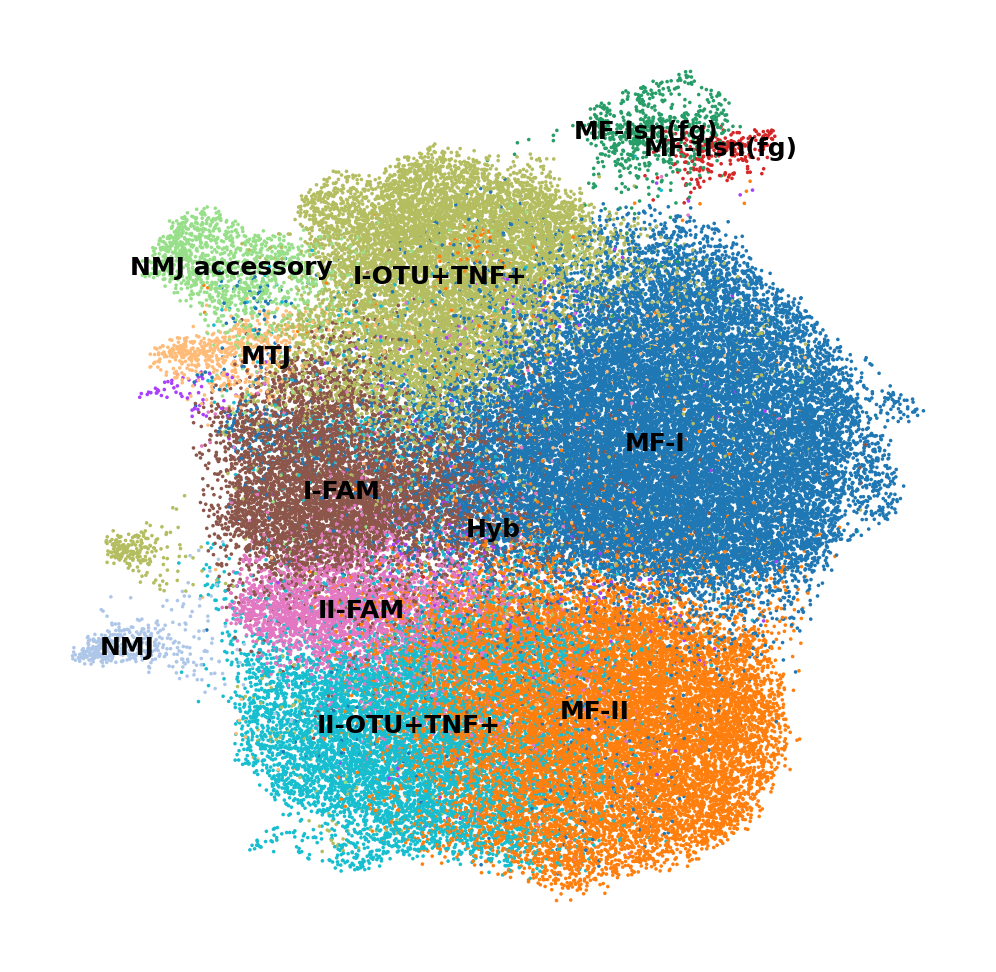

In [9]:
sc.pl.umap(adata_nc, color = ['annotation_level1'], legend_loc = "on data", legend_fontsize = 6, s = 3, 
          frameon = False, title = "", save = f"Myofiber_nuclei{today}.pdf")

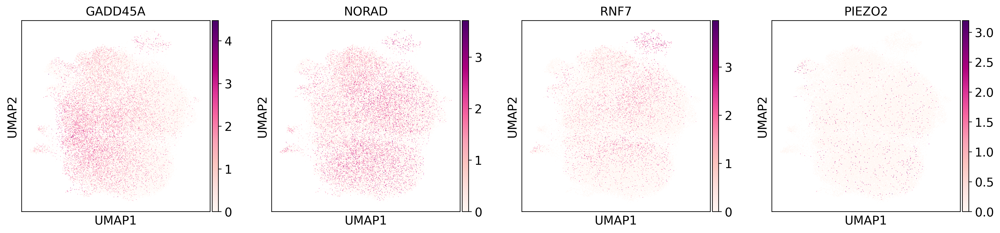

In [17]:
sc.pl.umap(adata_nc, color = ['GADD45A', 'NORAD', 'RNF7', 'PIEZO2'])

In [20]:
mn_mrkrs_new = { 'Damaged MN': ['GADD45A', 'NORAD', 'RNF7'],
                'Reactive MN': ['RUNX1', 'COL19A1', 'PRUNE2'],
                'NMJ acc': ['BMPR1B', 'COL14A1'],
                'Spindle': ['PIEZO2'], 
                'NMJ': ['ACHE', 'CHRNE', 'COLQ']
    
}

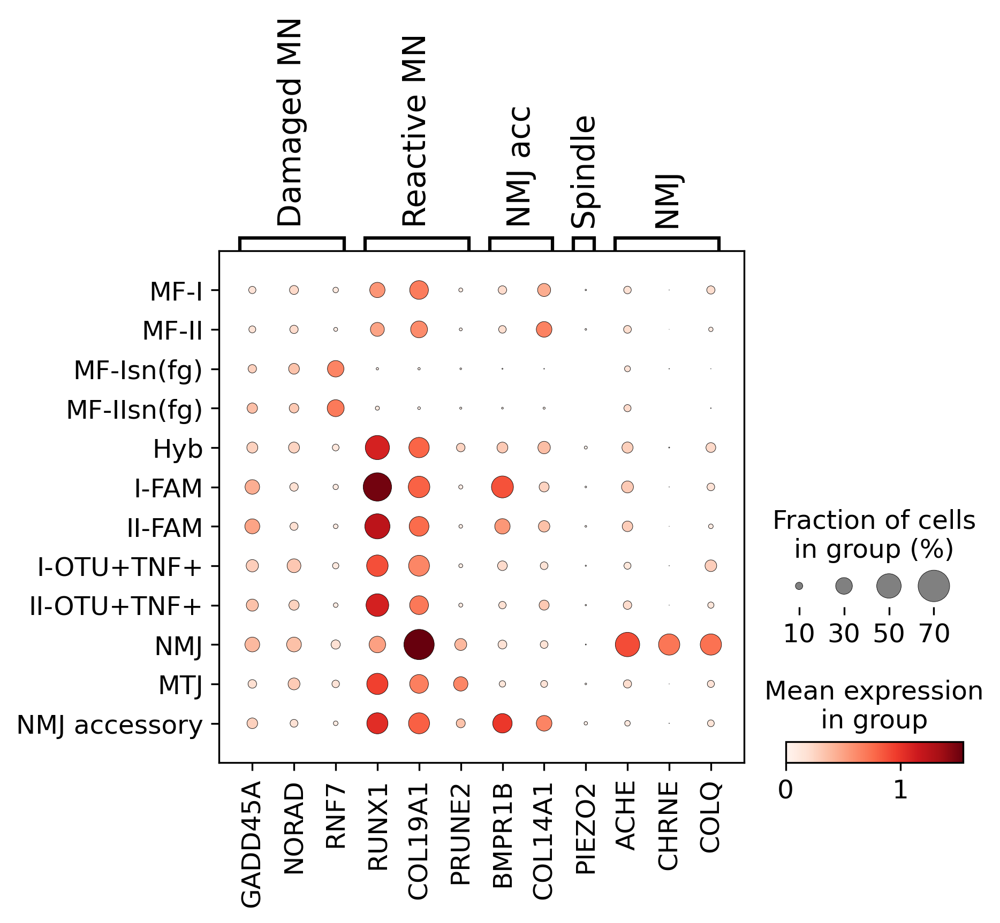

In [21]:
sc.pl.dotplot(adata_nc, var_names = mn_mrkrs_new, groupby = 'annotation_level1')

In [ ]:
sc.pl.umap(adata_nc, color = ['annotation_level1'], legend_loc = "on data", legend_fontsize = 6, s = 3, 
          frameon = False, title = "", save = f"Myofiber_nuclei{today}.pdf")

In [10]:
adata_nc[adata_nc.obs['DonorID'] == '583B',:].obs['annotation_level1'].value_counts()

I-FAM            596
MF-I             265
II-FAM           192
I-OTU+TNF+        58
MF-II             53
II-OTU+TNF+       48
MTJ               12
NMJ                6
Hyb                5
NMJ accessory      5
MF-Isn(fg)         1
MF-IIsn(fg)        1
Name: annotation_level1, dtype: int64

In [11]:
adata_nc[adata_nc.obs['DonorID'] == '583B',:].obs['myofiber_type'].value_counts()

nan           1215
MYH7+           17
MYH2+            5
MYH1+            4
MYH1+MYH7+       1
Name: myofiber_type, dtype: int64

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


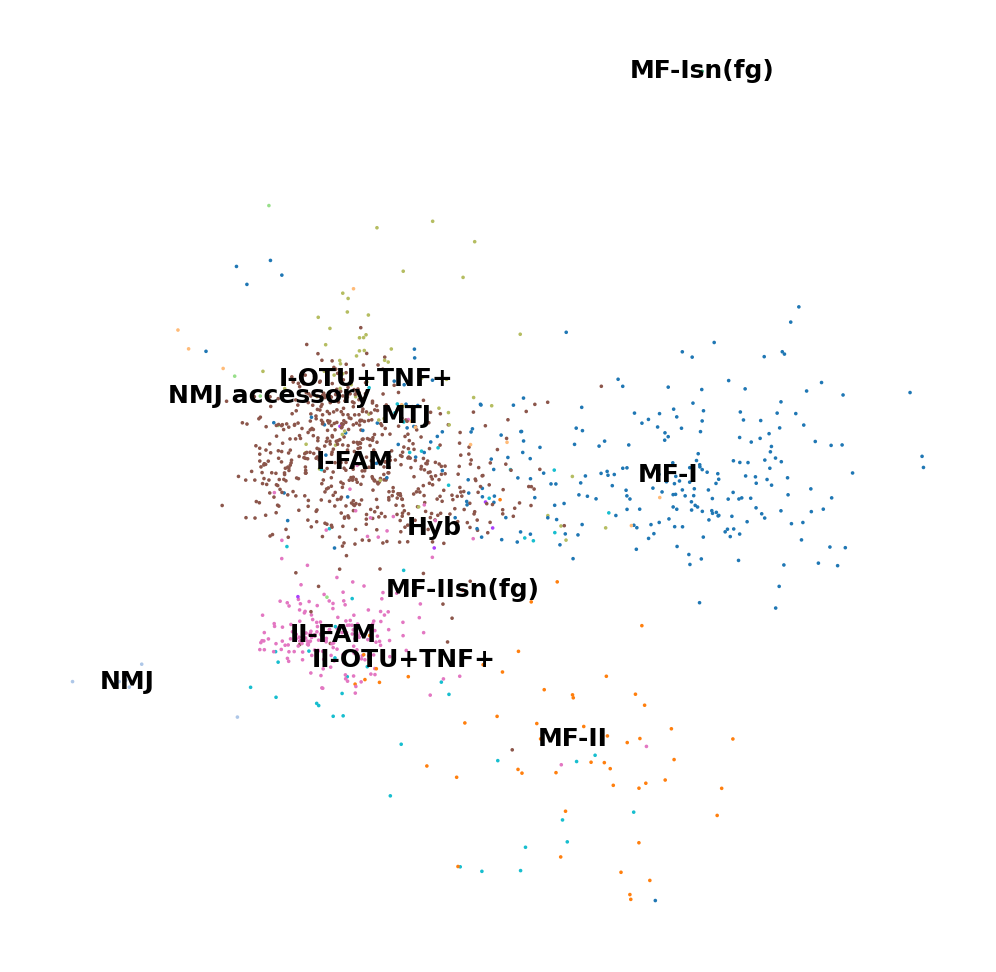

In [47]:
sc.pl.umap(adata_nc[adata_nc.obs['DonorID'] == '583B',:], color = ['annotation_level1'], legend_loc = "on data", legend_fontsize = 6, s = 3, 
          frameon = False, title = "", save = f"Myofiber_nuclei{today}.pdf")

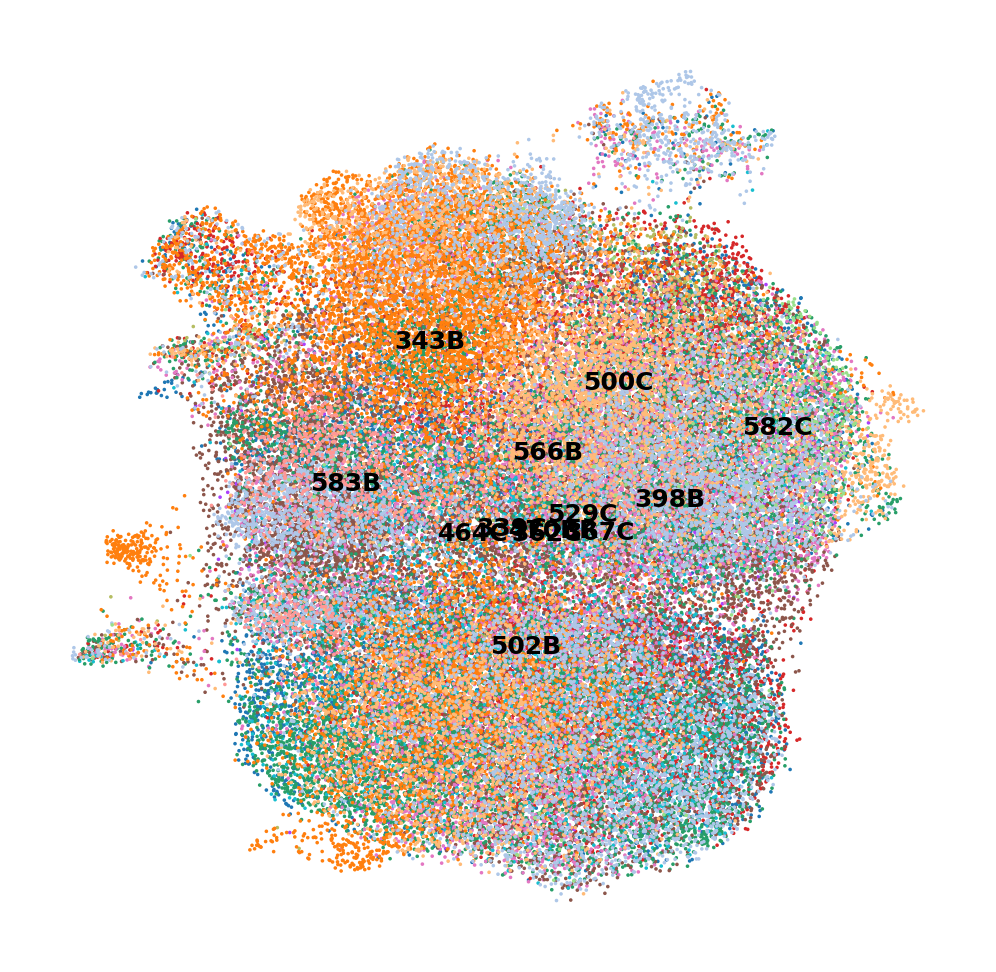

In [31]:
sc.pl.umap(adata_nc, color = ['DonorID'], legend_loc = "on data", legend_fontsize = 6, s = 3, 
          frameon = False, title = "", save = f"Myofiber_nuclei2Donor_{today}.pdf")

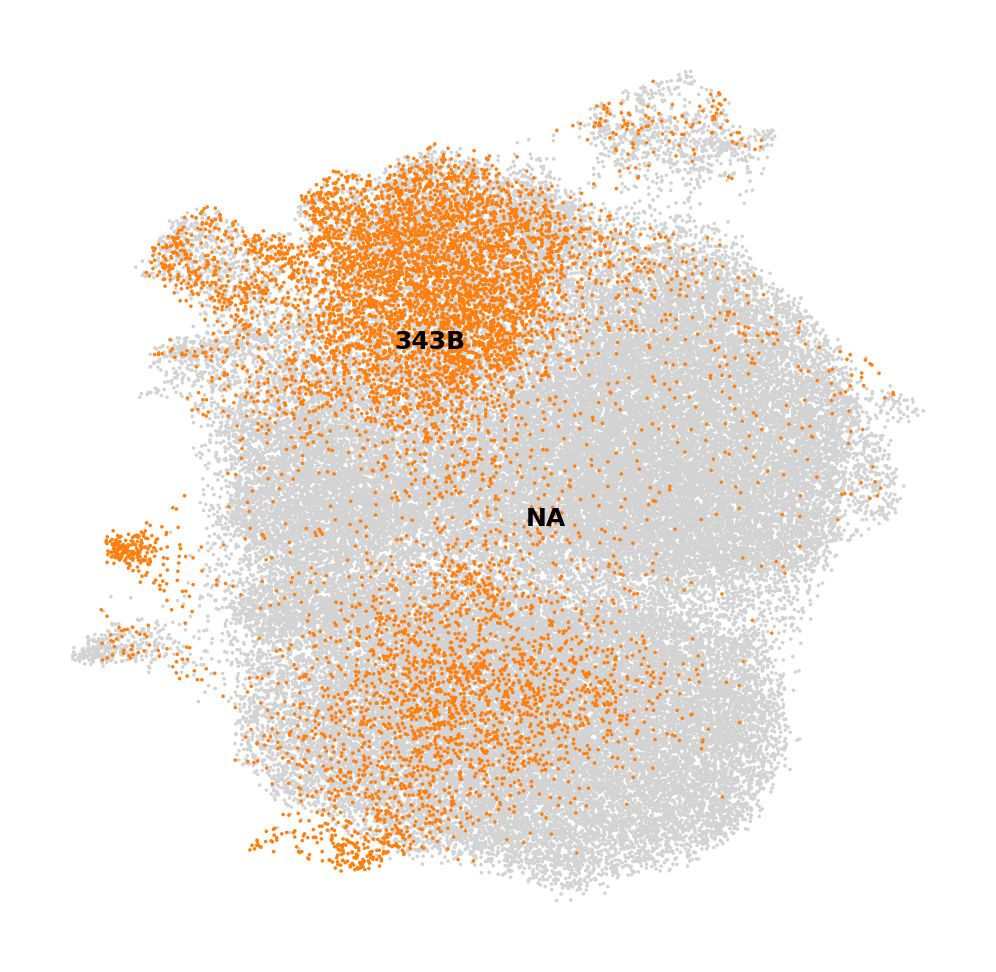

In [32]:
sc.pl.umap(adata_nc, color = ['DonorID'], groups = ['343B'], legend_loc = "on data", legend_fontsize = 6, s = 3, 
          frameon = False, title = "")

/nfs/team205/vk8/mambaforge/envs/scvelo/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


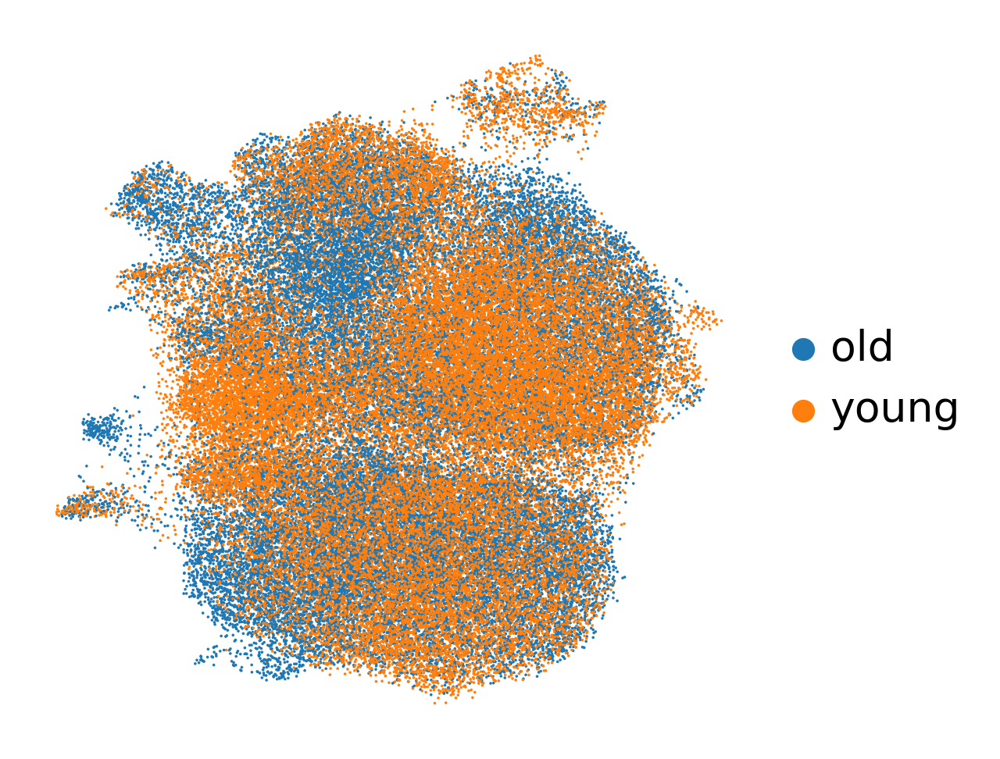

In [26]:
sc.pl.umap(adata_nc, color = ['Age_group'], s = 3, 
          frameon = False, title = "", save = f"Myofiber_nuclei_age{today}.pdf")

### 2. Plot markers genes for main nuclei populations

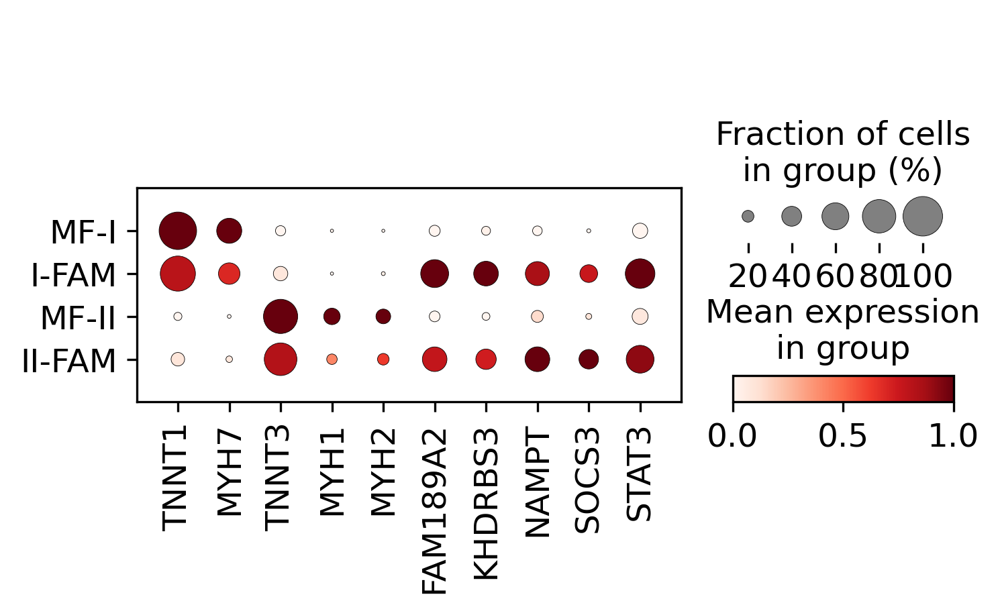

In [12]:
sc.pl.dotplot(adata_nc[adata_nc.obs['annotation_level1'].isin(['MF-I', 'I-FAM','MF-II', 'II-FAM'])], 
              groupby = 'annotation_level1', var_names = ['TNNT1', 'MYH7', 'TNNT3', 'MYH1', 'MYH2',
               'FAM189A2', 'KHDRBS3','NAMPT', 'SOCS3', 'STAT3'], standard_scale = "var",
             categories_order = ['MF-I', 'I-FAM','MF-II', 'II-FAM'], save = "FAM_mrkrs_plot1.pdf")


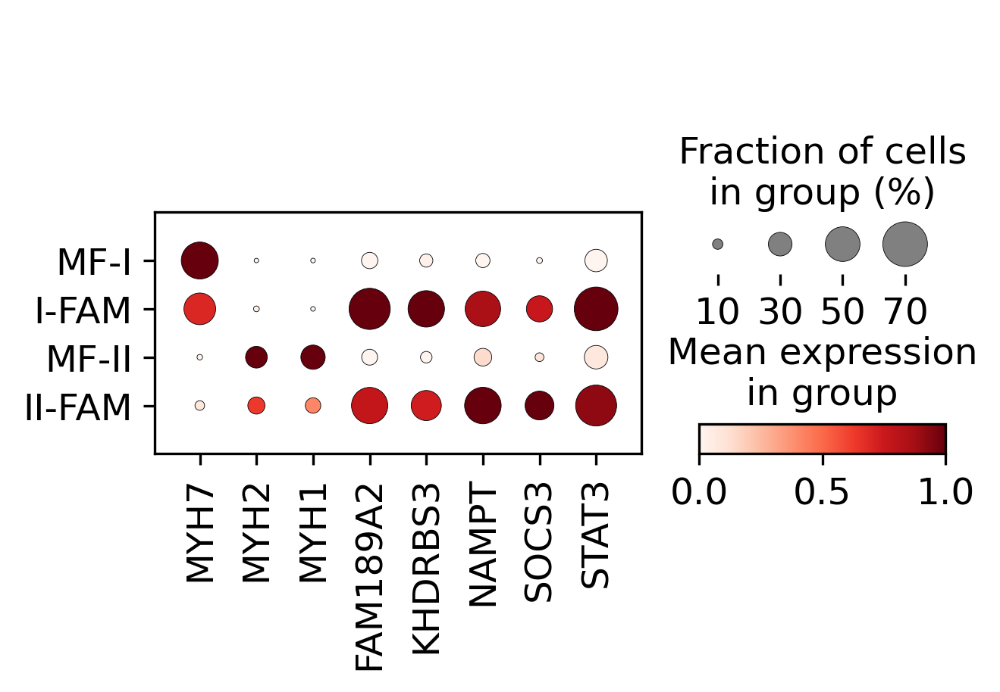

In [13]:
sc.pl.dotplot(adata_nc[adata_nc.obs['annotation_level1'].isin(['MF-I', 'I-FAM','MF-II', 'II-FAM'])], 
              groupby = 'annotation_level1', var_names = ['MYH7', 'MYH2','MYH1',
               'FAM189A2', 'KHDRBS3','NAMPT', 'SOCS3', 'STAT3'], standard_scale = "var",
             categories_order = ['MF-I', 'I-FAM','MF-II', 'II-FAM'], save = "FAM_mrkrs_plot2.pdf")


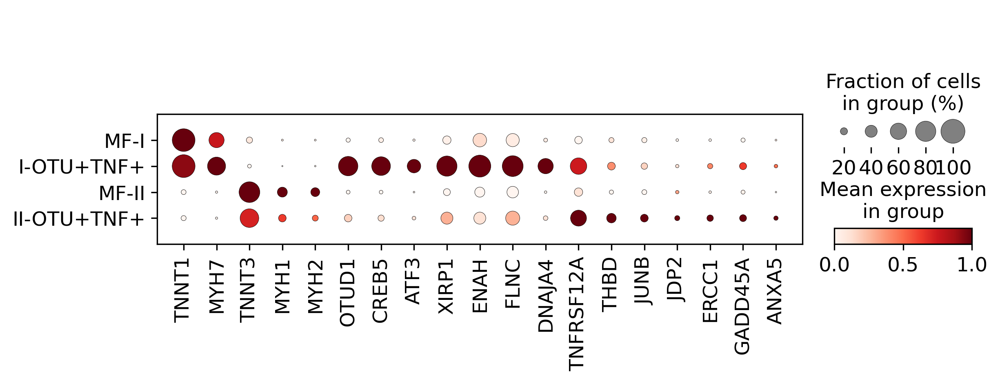

In [37]:
sc.pl.dotplot(adata_nc[adata_nc.obs['annotation_level1'].isin(['MF-I', 'I-OTU+TNF+', 'MF-II','II-OTU+TNF+',])], groupby = 'annotation_level1', var_names = ['TNNT1', 'MYH7', 'TNNT3', 'MYH1', 'MYH2',
                                                                     'OTUD1','CREB5', 'ATF3', 'XIRP1','ENAH', 'FLNC', 'DNAJA4',
                                                            'TNFRSF12A', 'THBD','JUNB', 'JDP2', 'ERCC1','GADD45A','ANXA5'], 
              categories_order = ['MF-I', 'I-OTU+TNF+', 'MF-II','II-OTU+TNF+',], standard_scale = "var",
              save = "OTU-TNF_mrkrs_plot1.pdf")

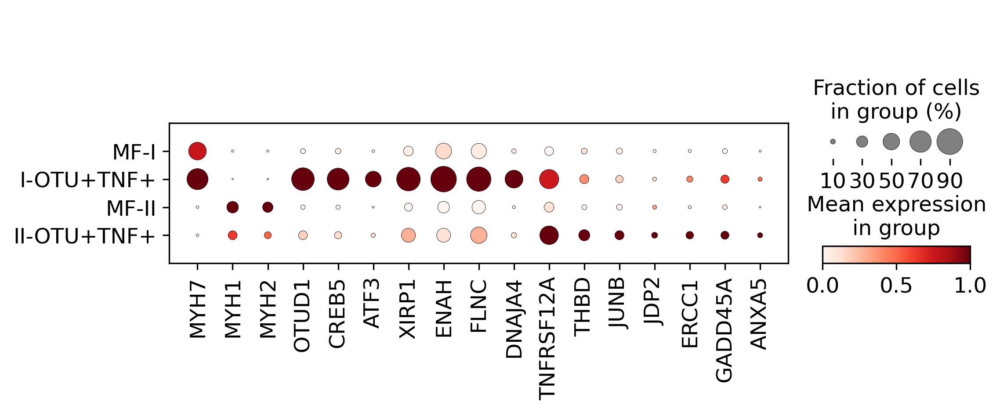

In [14]:
sc.pl.dotplot(adata_nc[adata_nc.obs['annotation_level1'].isin(['MF-I', 'I-OTU+TNF+', 'MF-II','II-OTU+TNF+',])], groupby = 'annotation_level1', var_names = ['MYH7', 'MYH1', 'MYH2',
                                                                     'OTUD1','CREB5', 'ATF3', 'XIRP1','ENAH', 'FLNC', 'DNAJA4',
                                                            'TNFRSF12A', 'THBD','JUNB', 'JDP2', 'ERCC1','GADD45A','ANXA5'], 
              categories_order = ['MF-I', 'I-OTU+TNF+', 'MF-II','II-OTU+TNF+',], standard_scale = "var",
              save = "OTU-TNF_mrkrs_plot2.pdf")

### 3. Plot markers genes for NMJ accessory populations

In [17]:
synapse_genes = [ 'MUSK', 'RAPSN', 'ACHE', 'PLCB4', 'CHRNE',
                 'DNER', 'CDH2', 'ADGRB3', 'EFNA5', 'CNTN5', 'PTPRD',# synapse assembly
                 'CDH2', 'RELN', 'PTPRD', # postsynaptic density organization
                 'SORBS2', 'DNER', 'CDH2', 'ADGRB3', 'ACTC1', 'UCHL1' #striated muscle cell differentiation
]

In [35]:
vae_mrks_dt_mfnuc = pd.read_csv(f"/{tables}/Supplementary_table5_p1_myonuclei_markers_scvi.csv", index_col = 0)

In [36]:
nmj_acc_mrkrs = vae_mrks_dt_mfnuc.loc[vae_mrks_dt_mfnuc['cluster'] == 'NMJ accessory'].index.tolist()

In [37]:
nmj_acc_enrich_df = sc.queries.enrich(nmj_acc_mrkrs,gprofiler_kwargs={'sources': ['GO:BP', 'REAC', 'KEGG'], 'no_evidences': False, 
                                                                             'all_results': True}, org="hsapiens")

In [38]:
go_nmj_acc = nmj_acc_enrich_df.loc[(nmj_acc_enrich_df['p_value']<0.1) & (nmj_acc_enrich_df['term_size']<500)]

In [22]:
go_nmj_acc.loc[go_nmj_acc['name'] == 'synaptic membrane adhesion', 'intersections'].tolist()
go_nmj_acc.loc[go_nmj_acc['name'] == 'synapse organization', 'intersections'].tolist()

[['IL1RAP', 'SPARCL1', 'EFNA5', 'PTPRD']]

[['CDH2',
  'BDNF',
  'IL1RAP',
  'STK38L',
  'SPARCL1',
  'DGKB',
  'APBB2',
  'EFNA5',
  'DOCK10',
  'NRXN3',
  'PTPRD']]

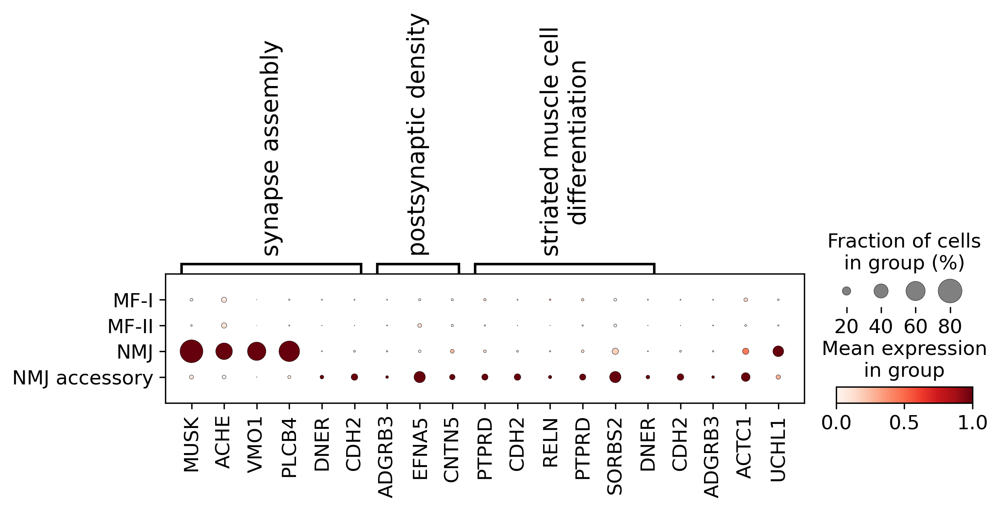

In [23]:
sc.pl.dotplot(adata_nc[adata_nc.obs['annotation_level1'].isin(['MF-I', 'MF-II', 'NMJ', 'NMJ accessory',])], groupby = 'annotation_level1', 
              var_names = synapse_genes,
              categories_order = ['MF-I', 'MF-II', 'NMJ', 'NMJ accessory'],
             var_group_positions = [(0,5), (6,8), (9,14)], var_group_labels = ['synapse assembly', 'postsynaptic density','striated muscle cell\ndifferentiation'],               
              standard_scale = "var",
              save = "NMJaccessory_mrkrs_plot.pdf")

In [24]:
nmj_acc_mrkrs = ['MUSK', 'ACHE', 'PLCB4','CHRNE', 
                 'SORBS2', 'BMPR1B', 'GRIA2', 'STYK1',
                'CDH2','BDNF','IL1RAP','STK38L','SPARCL1','DGKB','APBB2','EFNA5','DOCK10','NRXN3','PTPRD']

In [ ]:
'MUSK', 'RAPSN', 'ACHE', 'PLCB4', 'CHRNE'

In [19]:
nmj_acc_mrkrs = ['MUSK', 'RAPSN', 'LRP4', 'DOK7', 'GDNF', 'BDNF', 'ACHE', 'NCAM', 'PLCB4', 'CHRNE',
                 'SORBS2', 'BMPR1B', 'GRIA2', 'STYK1',
                'CDH2','BDNF','IL1RAP','STK38L','SPARCL1','DGKB','APBB2','EFNA5','DOCK10','NRXN3','PTPRD']

In [10]:
len(nmj_acc_mrkrs)

20

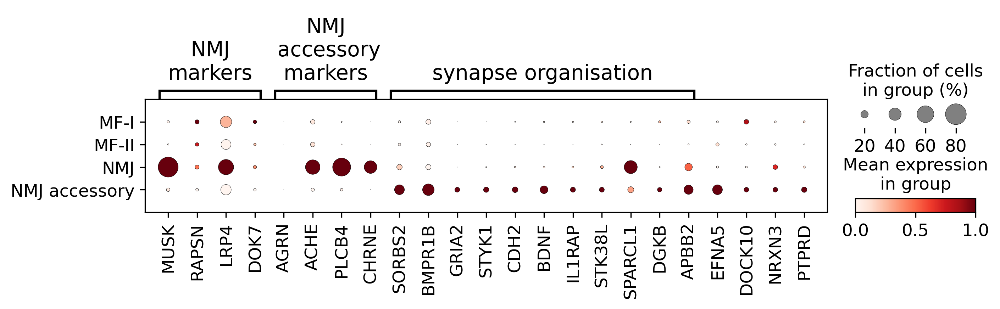

In [14]:
sc.pl.dotplot(adata_nc[adata_nc.obs['annotation_level1'].isin(['MF-I', 'MF-II', 'NMJ','NMJ accessory',])], groupby = 'annotation_level1', 
              var_names = nmj_acc_mrkrs,
              categories_order = ['MF-I', 'MF-II', 'NMJ','NMJ accessory'], 
               var_group_positions = [(0,3), (4,7), (8,18)],
              var_group_labels = ['NMJ\nmarkers', 'NMJ\n accessory\nmarkers','synapse organisation'],   
              var_group_rotation = 0,
              standard_scale = "var",
              save = "NMJaccessory_mrkrs_plot2.pdf")

In [39]:
go_nmj_acc.loc[go_nmj_acc['name'] == 'synaptic membrane adhesion', 'intersections'].tolist()
go_nmj_acc.loc[go_nmj_acc['name'] == 'synapse organization', 'intersections'].tolist()

[['IL1RAP', 'SPARCL1', 'EFNA5', 'PTPRD']]

[['CDH2',
  'BDNF',
  'IL1RAP',
  'STK38L',
  'SPARCL1',
  'DGKB',
  'APBB2',
  'EFNA5',
  'DOCK10',
  'NRXN3',
  'PTPRD']]

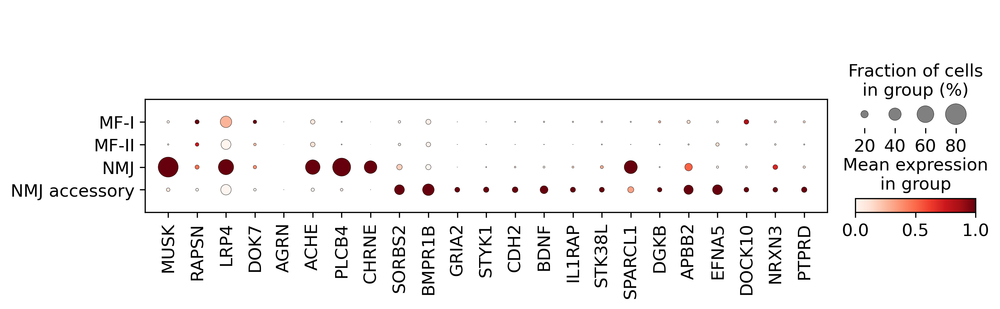

In [15]:
sc.pl.dotplot(adata_nc[adata_nc.obs['annotation_level1'].isin(['MF-I', 'MF-II', 'NMJ','NMJ accessory',])], groupby = 'annotation_level1', 
              var_names = nmj_acc_mrkrs,
              categories_order = ['MF-I', 'MF-II', 'NMJ','NMJ accessory'], 
              standard_scale = "var",
              save = "NMJaccessory_mrkrs_plot2.pdf")

In [33]:
nmj_acc_mrkrs_rev = ['MUSK', 'RAPSN', 'LRP4', 'DOK7','ACHE','CHRNE', 'PLCB4', 'NCAM1', 'GDNF', 'BDNF', 
                 'SORBS2', 'EFNA5','GRIA2', 'BMPR1B', 'STYK1',
                'CDH2','IL1RAP','STK38L','SPARCL1','DGKB','APBB2','DOCK10','NRXN3','PTPRD']

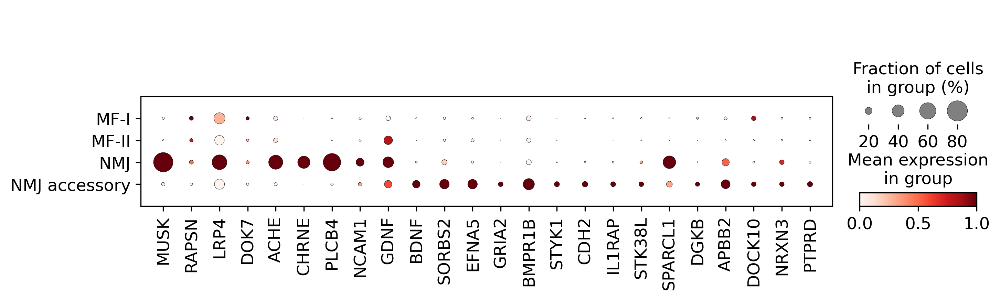

In [34]:
sc.pl.dotplot(adata_nc[adata_nc.obs['annotation_level1'].isin(['MF-I', 'MF-II', 'NMJ','NMJ accessory',])], groupby = 'annotation_level1', 
              var_names = nmj_acc_mrkrs_rev,
              categories_order = ['MF-I', 'MF-II', 'NMJ','NMJ accessory'], 
              standard_scale = "var",
              save = "NMJaccessory_mrkrs_rev.pdf")

In [41]:
nmj_acc_mrkrs_rev_filt = ['MUSK', 'LRP4','ACHE', 'PLCB4', 'CHRNE',
                 'SORBS2', 'BMPR1B', 'GRIA2', 'STYK1',
                'CDH2','BDNF','IL1RAP','STK38L','SPARCL1','DGKB','APBB2','EFNA5','DOCK10','NRXN3','PTPRD']

In [39]:
go_nmj_acc.loc[go_nmj_acc['name'] == 'synaptic membrane adhesion', 'intersections'].tolist()
go_nmj_acc.loc[go_nmj_acc['name'] == 'synapse organization', 'intersections'].tolist()

[['IL1RAP', 'SPARCL1', 'EFNA5', 'PTPRD']]

[['CDH2',
  'BDNF',
  'IL1RAP',
  'STK38L',
  'SPARCL1',
  'DGKB',
  'APBB2',
  'EFNA5',
  'DOCK10',
  'NRXN3',
  'PTPRD']]

In [40]:
sc.pl.dotplot(adata_nc[adata_nc.obs['annotation_level1'].isin(['MF-I', 'MF-II', 'NMJ','NMJ accessory',])], groupby = 'annotation_level1', 
              var_names = nmj_acc_mrkrs_rev_filt,
              categories_order = ['MF-I', 'MF-II', 'NMJ','NMJ accessory'], 
              standard_scale = "var",
              save = "NMJaccessory_mrkrs_plot_rev_filt.pdf")

NameError: name 'nmj_acc_mrkrs_rev_filt' is not defined

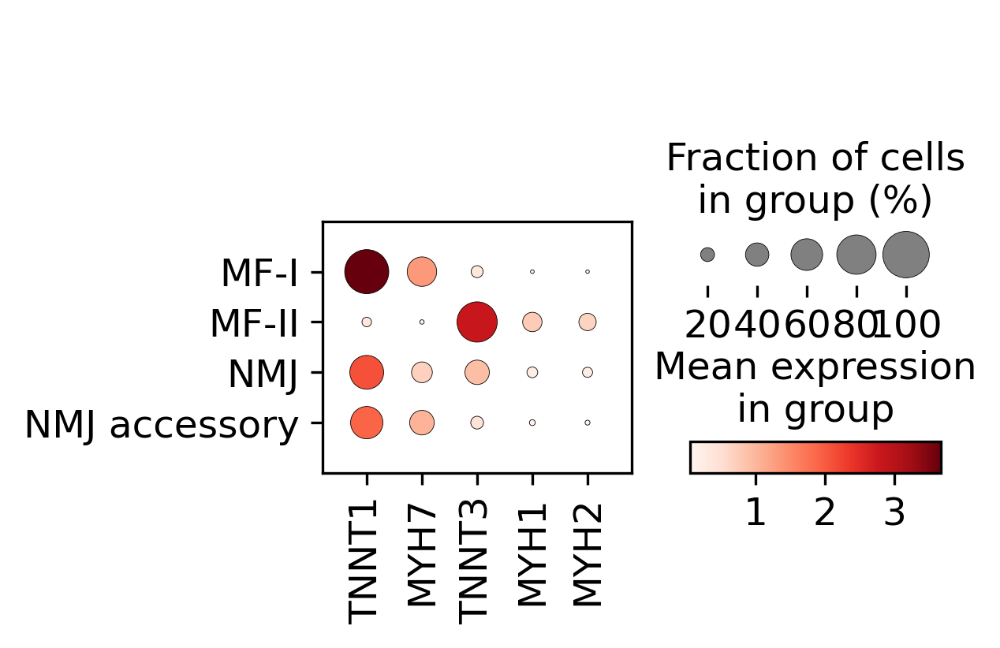

In [28]:
sc.pl.dotplot(adata_nc[adata_nc.obs['annotation_level1'].isin(['MF-I', 'MF-II', 'NMJ','NMJ accessory',])], groupby = 'annotation_level1', 
              var_names = ['TNNT1', 'MYH7', 'TNNT3', 'MYH1', 'MYH2'],
              categories_order = ['MF-I', 'MF-II', 'NMJ','NMJ accessory'], 
              save = "Fast_vs_slow_NMJacc.pdf")

In [73]:
adata_nc.obs['Age_group'] = adata_nc.obs['Age_group'].cat.reorder_categories(['young', 'old'])

In [107]:
import sys

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

import scanpy as sc
import scvi

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

from datetime import date
today = str(date.today())

import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'pdf')


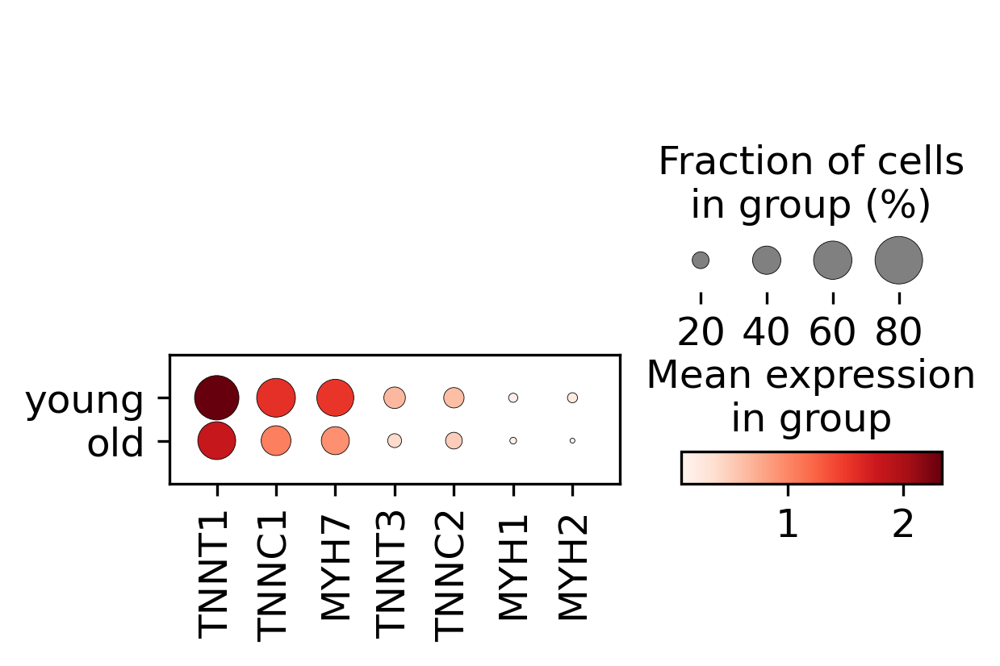

In [75]:
sc.pl.dotplot(adata_nc[adata_nc.obs['annotation_level1']=='NMJ accessory',], groupby = 'Age_group', 
              var_names = ['TNNT1','TNNC1', 'MYH7', 'TNNT3','TNNC2', 'MYH1', 'MYH2'],
             # categories_order = ['MF-I', 'MF-II', 'NMJ','NMJ accessory'], 
              save = "Fast_vs_slow_NMJacc.pdf")

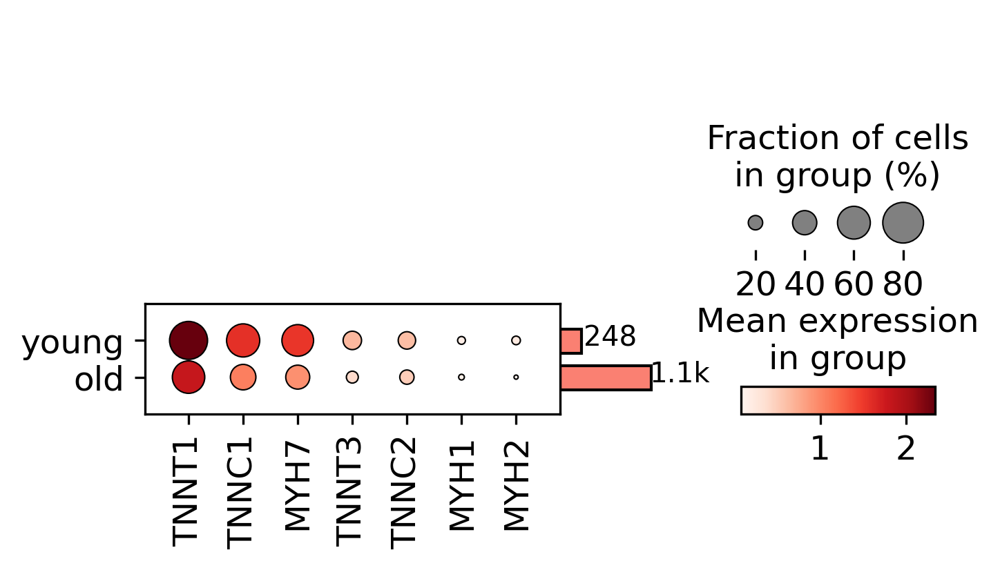

In [110]:
dp_nmj_acc = sc.pl.dotplot(adata_nc[adata_nc.obs['annotation_level1']=='NMJ accessory',], groupby = 'Age_group', 
              var_names = ['TNNT1','TNNC1', 'MYH7', 'TNNT3','TNNC2', 'MYH1', 'MYH2'],
             # categories_order = ['MF-I', 'MF-II', 'NMJ','NMJ accessory'], 
             return_fig=True)

dp_nmj_acc = dp_nmj_acc.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5, cmap = "Reds")
dp_nmj_acc.savefig(f"{figures}/NMJ_acc.slow2fast.pdf")

In [ ]:
sc.pl.dotplot(adata_nc, var_names = synapse_genes, \
              groupby = 'annotation_level1', standard_scale = 'var', figsize = (6,4), 
             var_group_positions = [(0,5), (6,8), (9,14)], var_group_labels = ['synapse assembly', 'postsynaptic density', \
                                                                              'striated muscle cell\ndifferentiation'], 
              save = 'SKM_synaptic_genes_dotplot_'+today+ '.pdf', swap_axes = False)

### 4. Perform GO enrichments on FAM+, OTU+TNF+ and NMJ accessory nuclei populations

In [15]:
vae_mfnuc = scvi.model.SCVI.load(f"{model_folder}/ICM_myonuclei_data_scvi1_2023-05-07")

INFO     Using data from adata.X                                                             


/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function transfer_anndata_setup is deprecated; This method will be removed in 0.15.0. Please avoid building any new dependencies on it.
  warnings.warn(msg, category=FutureWarning)


INFO     Registered keys:['X', 'batch_indices', 'labels', 'cat_covs', 'cont_covs']           
INFO     Successfully registered anndata object containing 74855 cells, 10003 vars, 22       
         batches, 1 labels, and 0 proteins. Also registered 3 extra categorical covariates   
         and 1 extra continuous covariates.                                                  


In [16]:
vae_mfnuc.adata.obs['annotation_level1'] = adata_nc.obs.reindex(vae_mfnuc.adata.obs_names)['annotation_level1']

In [17]:
vae_mfnuc.adata.obs['annotation_level1'].cat.categories

Index(['MF-I', 'MF-II', 'MF-Isn(fg)', 'MF-IIsn(fg)', 'Hyb', 'I-FAM', 'II-FAM',
       'I-OTU+TNF+', 'II-OTU+TNF+', 'NMJ', 'MTJ', 'NMJ accessory'],
      dtype='object')

In [18]:
def scvi_markers_compare(vae, cluster, group_1, group_2):
    results = {}
    de_df = vae.differential_expression(
    groupby=cluster, group1 = group_1, group2 = group_2)
    de_df['cluster'] = de_df['group1']
    de_df = de_df.loc[(de_df.lfc_mean>1)&(de_df.bayes_factor>2) &(de_df.non_zeros_proportion1>0.1)]
    markers = de_df.index.tolist()
    results['de_df'] = de_df
    results['markers'] = markers
    #print(results)
    return(results)

In [19]:
de_groups_mfnuc = [('I-FAM', 'MF-I'), ('II-FAM', 'MF-II'), ('I-OTU+TNF+', 'MF-I'),\
 ('II-OTU+TNF+', 'MF-II'), ('NMJ accessory', None), ('NMJ', None), \
             ('MTJ', None)]

In [20]:
##bayes factor > 2.5
de_mrks_dict2 = {}
de_df_list2 = []
for i in de_groups_mfnuc:
    df2 = scvi_markers_compare (vae_mfnuc, cluster = 'annotation_level1', group_1=i[0], group_2=i[1])
    de_mrks_dict2[i[0]] = df2['markers']
    de_df_list2.append(df2['de_df'])  

DE...: 100%|██████████| 1/1 [00:08<00:00,  8.05s/it]


In [46]:
tables

'/nfs/team205/vk8/scripts/scvi/SKM_analyses_rev1/tables'

In [21]:
vae_mrks_dt_mfnuc2 = pd.concat(de_df_list2)
vae_mrks_dt_mfnuc2.to_csv(f"/{tables}/Supplementary_table5_p2_myofiber_markers_scvi_comparison_v2_reanalysis.csv")

In [22]:
myofiber_clust_enrich_df = sc.queries.enrich(de_mrks_dict2,gprofiler_kwargs={'sources': ['GO:BP', 'REAC', 'KEGG'], 'no_evidences': False, 'all_results': True}, org="hsapiens")
myofiber_clust_enrich_df.significant = myofiber_clust_enrich_df.p_value<0.1
myofiber_clust_enrich_df.significant.sum()

821

In [23]:
myofiber_clust_enrich_df['f'] = 2*myofiber_clust_enrich_df.precision*myofiber_clust_enrich_df.recall / \
(myofiber_clust_enrich_df.precision+myofiber_clust_enrich_df.recall)

myofiber_clust_enrich_df['neglogfdr'] = -np.log10(myofiber_clust_enrich_df.p_value)

In [30]:
myofiber_clust_enrich_df.to_csv(f"/{tables}/Myofiber_nuclei_GO_enrichment_all_v2_reanalysis.csv", index = False)

In [6]:
myofiber_clust_enrich_df = pd.read_csv(f"/{tables}/Myofiber_nuclei_GO_enrichment_all_v2_reanalysis.csv")

In [7]:
myofiber_clust_enrich_df

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents,intersections,evidences,f,neglogfdr
0,REAC,REAC:R-HSA-156902,Peptide chain elongation,3.630948e-106,True,Peptide chain elongation,90,141,65,10790,0.460993,0.722222,MTJ,['REAC:R-HSA-156842'],"['RPS18', 'EEF1A1', 'RPL34', 'RPL35A', 'RPS6',...","[['REAC'], ['REAC'], ['REAC'], ['REAC'], ['REA...",0.562771,105.439980
1,REAC,REAC:R-HSA-156842,Eukaryotic Translation Elongation,4.532852e-104,True,Eukaryotic Translation Elongation,94,141,65,10790,0.460993,0.691489,MTJ,['REAC:R-HSA-72766'],"['RPS18', 'EEF1A1', 'RPL34', 'RPL35A', 'RPS6',...","[['REAC'], ['REAC'], ['REAC'], ['REAC'], ['REA...",0.553191,103.343628
2,REAC,REAC:R-HSA-192823,Viral mRNA Translation,1.252679e-103,True,Viral mRNA Translation,90,141,64,10790,0.453901,0.711111,MTJ,['REAC:R-HSA-168273'],"['RPS18', 'RPL34', 'RPL35A', 'RPS6', 'RPL29', ...","[['REAC'], ['REAC'], ['REAC'], ['REAC'], ['REA...",0.554113,102.902160
3,REAC,REAC:R-HSA-2408557,Selenocysteine synthesis,1.354832e-101,True,Selenocysteine synthesis,94,141,64,10790,0.453901,0.680851,MTJ,['REAC:R-HSA-2408522'],"['RPS18', 'RPL34', 'RPL35A', 'RPS6', 'RPL29', ...","[['REAC'], ['REAC'], ['REAC'], ['REAC'], ['REA...",0.544681,100.868114
4,REAC,REAC:R-HSA-72764,Eukaryotic Translation Termination,1.354832e-101,True,Eukaryotic Translation Termination,94,141,64,10790,0.453901,0.680851,MTJ,['REAC:R-HSA-72766'],"['RPS18', 'RPL34', 'RPL35A', 'RPS6', 'RPL29', ...","[['REAC'], ['REAC'], ['REAC'], ['REAC'], ['REA...",0.544681,100.868114
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27146,GO:BP,GO:0016567,protein ubiquitination,1.000000e+00,False,"""The process in which one or more ubiquitin gr...",830,111,10,21110,0.090090,0.012048,I-OTU+TNF+,['GO:0032446'],"['HSPA1A', 'RNF115', 'ASB5', 'ASB18', 'KLHL40'...","[['IDA'], ['IDA', 'ISS', 'IEA'], ['IBA', 'IEA'...",0.021254,-0.000000
27147,GO:BP,GO:0016525,negative regulation of angiogenesis,1.000000e+00,False,"""Any process that stops, prevents, or reduces ...",103,111,2,21110,0.018018,0.019417,I-OTU+TNF+,"['GO:0001525', 'GO:0045765', 'GO:2000181']","['TGFB2', 'ATP2B4']","[['IDA'], ['IDA', 'IEA']]",0.018692,-0.000000
27148,GO:BP,GO:0016485,protein processing,1.000000e+00,False,"""Any protein maturation process achieved by th...",250,111,1,21110,0.009009,0.004000,I-OTU+TNF+,"['GO:0006508', 'GO:0051604']",['MYH9'],"[['ISS', 'IEA']]",0.005540,-0.000000
27149,GO:BP,GO:0017015,regulation of transforming growth factor beta ...,1.000000e+00,False,"""Any process that modulates the frequency, rat...",140,111,2,21110,0.018018,0.014286,I-OTU+TNF+,"['GO:0007179', 'GO:0090092', 'GO:1903844']","['HSPA1A', 'HIPK2']","[['IMP'], ['IMP']]",0.015936,-0.000000


In [30]:
myofiber_clust_enrich_df.significant = myofiber_clust_enrich_df.p_value<0.05
myofiber_clust_enrich_df_sign = myofiber_clust_enrich_df.loc[(myofiber_clust_enrich_df['significant'] == True) & \
                                                            (myofiber_clust_enrich_df['term_size'] <500) & \
                                                            (myofiber_clust_enrich_df['term_size']>10) ,:].copy()

In [31]:
myofiber_clust_enrich_df_sign['query'].value_counts()

query
MTJ              126
NMJ               73
I-OTU+TNF+        56
II-FAM            21
I-FAM             16
II-OTU+TNF+       12
NMJ accessory      7
Name: count, dtype: int64

In [20]:
myofiber_clust_enrich_df_sign.to_csv(f"/{tables}/Supplementary_table5_p3_myofiber_nuclei_GO_enrichment_v2_reanalysis.csv", index = False)

myofiber_clust_enrich_df_sign = pd.read_csv(f"/{tables}/Supplementary_table5_p3_myofiber_nuclei_GO_enrichment_v2_reanalysis.csv")

In [36]:
pathways = ['response to stress', 'JAK-STAT signaling pathway', 'Cellular senescence', 'Metallothioneins bind metals',\
           'skeletal muscle tissue development', 'skeletal muscle cell differentiation', 'MAPK signaling pathway', 'cellular response to unfolded protein', 
            'protein refolding',\
           'wound healing', 'blood coagulation', 'synapse organization','regulation of synapse organization', 
            'axon development', 'activation of protein kinase activity',]

pathways2 =  ['response to stress','Interleukin-4 and Interleukin-13 signaling', 'stress-activated MAPK cascade',
             'Growth hormone receptor signaling', 'muscle organ development', 'skeletal muscle cell differentiation',
              'protein refolding', 'calcineurin-mediated signaling', 'wound healing', 'blood coagulation', 
              'synapse organization','synaptic membrane adhesion', 'axon development']

mf_path_df2 = myofiber_clust_enrich_df.loc[myofiber_clust_enrich_df['name'].isin(pathways2)].copy()
mf_path_df1 = myofiber_clust_enrich_df.loc[myofiber_clust_enrich_df['name'].isin(pathways)].copy()

mf_path_df1['query'] = mf_path_df1['query'].astype("category")
mf_path_df1['name'] = mf_path_df1['name'].astype("category")
mf_path_df1['query'] = mf_path_df1['query'].cat.reorder_categories(new_categories = ['MTJ', 'NMJ', 'NMJ accessory', 'II-OTU+TNF+',
                                                             'I-OTU+TNF+','II-FAM',\
                                                             'I-FAM']).copy()
mf_path_df1['name'] = mf_path_df1['name'].cat.reorder_categories(new_categories = pathways).copy()


mf_path_df2['query'] = mf_path_df2['query'].astype("category")
mf_path_df2['name'] = mf_path_df2['name'].astype("category")
mf_path_df2['query'] = mf_path_df2['query'].cat.reorder_categories(new_categories = ['MTJ', 'NMJ', 'NMJ accessory', 'II-OTU+TNF+',
                                                             'I-OTU+TNF+','II-FAM',\
                                                             'I-FAM']).copy()
mf_path_df2['name'] = mf_path_df2['name'].cat.reorder_categories(new_categories = pathways2).copy()

In [70]:
from plotnine import *
g = (
    ggplot(mf_path_df1, aes(x='query', y='name')) +
    geom_point(aes(size='neglogfdr', fill = 'f', color='significant'), stroke=1)+
  #  facet_wrap('common', nrow=1, scales='free_x') + 
    #scale_fill_distiller(type='div', limits=limit, name='log(odds ratio)') + 
  #  scale_fill_cmap('Blues', limits=[0, None]) +
  #  scale_color_manual(values=('#808080', '#990E1D')) + 
   # labs(size = "-log10(adj. P value)", y='Muscle disease group', x='', title='') +
  #  guides(size = guide_legend(reverse=True)) +
  #  scale_fill_cmap('Blues', limits=[0, None]) +
    scale_color_manual(values=('#808080', '#990E1D')) + 
    labs(size = "-log10(adj. P value)", y='', x='', title='') +
    guides(size = guide_legend(reverse=True),  color=guide_colorbar(raster=False, nbin=100)) +
    theme_linedraw() +
    scale_size(range = (1,10)) +
    scale_y_discrete(drop=False) +
    coord_flip()+
    #scale_x_discrete(drop=False) +
    theme(
     strip_text_x = element_text(size=12, color='black', angle = 0),
     strip_text_y = element_text(size=12, color='black', angle = 0),      
     strip_background=element_rect(color='black', fill='white'),
      legend_key=element_blank(),
      axis_text_x = element_text(rotation=60, hjust=1.),
    )
)

/nfs/team205/vk8/mambaforge/envs/milopy-env/lib/python3.9/site-packages/plotnine/guides/guide_colorbar.py:73: PlotnineWarning: colorbar guide needs continuous scales


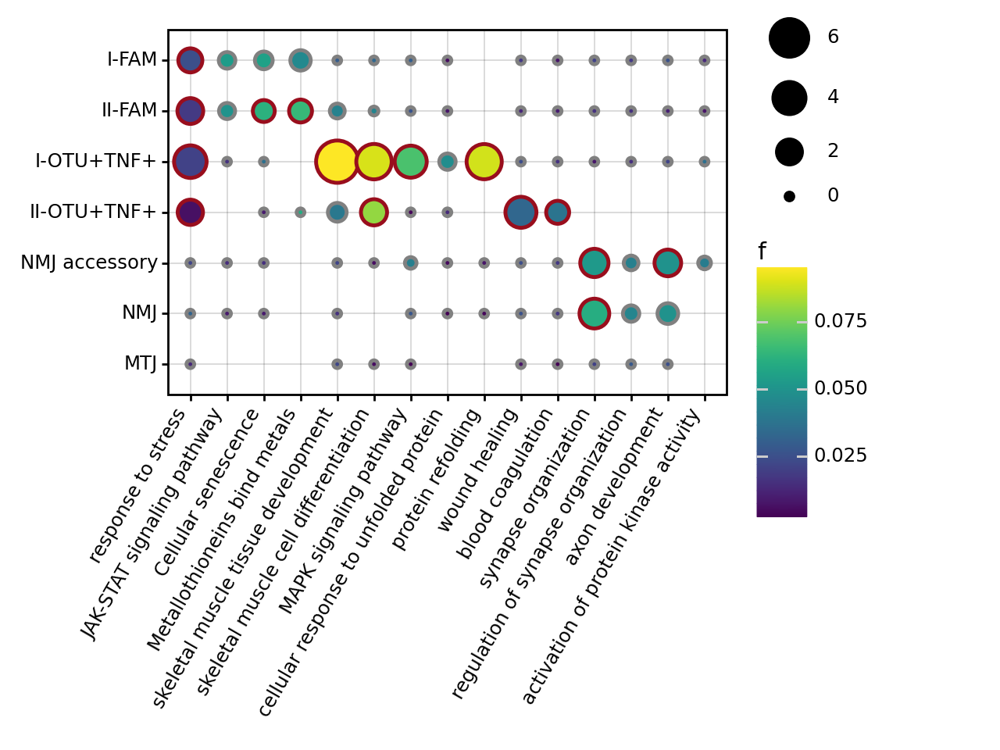

<Figure Size: (640 x 480)>

In [71]:
g

/nfs/team205/vk8/mambaforge/envs/milopy-env/lib/python3.9/site-packages/plotnine/guides/guide_colorbar.py:73: PlotnineWarning: colorbar guide needs continuous scales


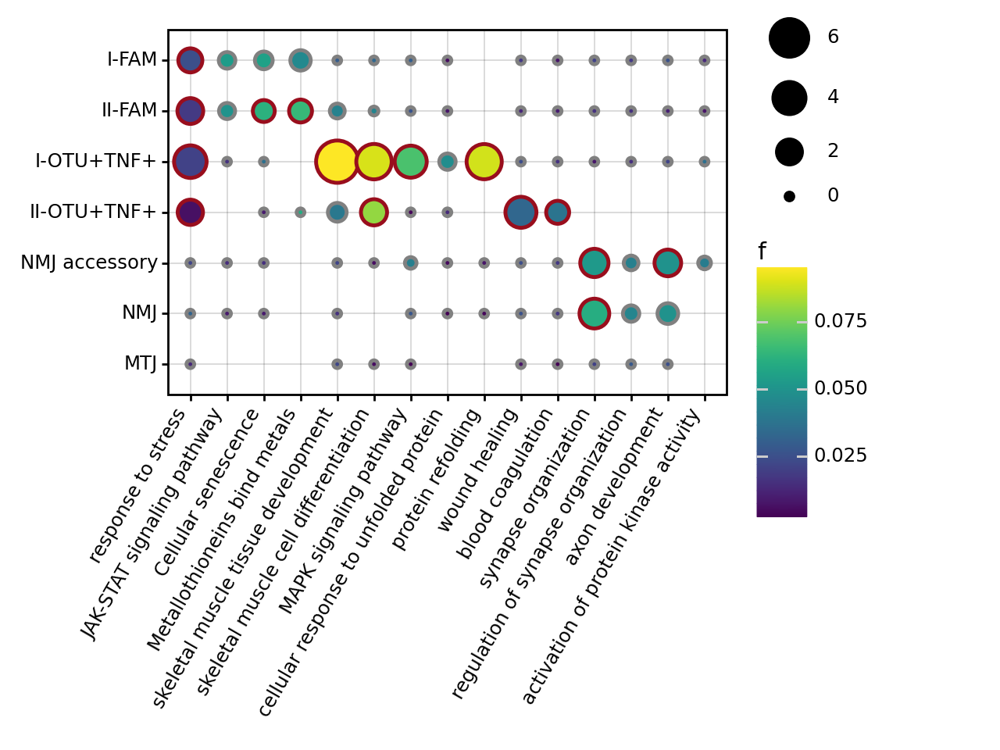

<Figure Size: (640 x 480)>

In [76]:
g

In [77]:
g.save(f"/{figures}/Figure3_enrichments_reanalysis_origin.pdf",  dpi = 300)

/nfs/team205/vk8/mambaforge/envs/milopy-env/lib/python3.9/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 6.4 x 4.8 in image.
/nfs/team205/vk8/mambaforge/envs/milopy-env/lib/python3.9/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: //nfs/team205/vk8/scripts/scvi/SKM_analyses_rev1/figures/Figure3_enrichments_reanalysis_origin.pdf
/nfs/team205/vk8/mambaforge/envs/milopy-env/lib/python3.9/site-packages/plotnine/guides/guide_colorbar.py:73: PlotnineWarning: colorbar guide needs continuous scales


In [84]:
from plotnine import *
g2 = (
    ggplot(mf_path_df2, aes(x='query', y='name')) +
    geom_point(aes(size='neglogfdr', fill = 'f', color='significant'), stroke=1)+
  #  facet_wrap('common', nrow=1, scales='free_x') + 
    #scale_fill_distiller(type='div', limits=limit, name='log(odds ratio)') + 
  #  scale_fill_cmap('Blues', limits=[0, None]) +
  #  scale_color_manual(values=('#808080', '#990E1D')) + 
   # labs(size = "-log10(adj. P value)", y='Muscle disease group', x='', title='') +
  #  guides(size = guide_legend(reverse=True)) +
  #  scale_fill_cmap('Blues', limits=[0, None]) +
    scale_color_manual(values=('#808080', '#990E1D')) + 
    labs(size = "-log10(adj. P value)", y='', x='', title='') +
    guides(size = guide_legend(reverse=True))+ #, color=guide_colorbar(raster=False, nbin=100)) +
    theme_linedraw() +
    scale_size(range = (1,10)) +
    scale_y_discrete(drop=False) +
    coord_flip()+
    #scale_x_discrete(drop=False) +
    theme(
     strip_text_x = element_text(size=12, color='black', angle = 0),
     strip_text_y = element_text(size=12, color='black', angle = 0),      
     strip_background=element_rect(color='black', fill='white'),
      legend_key=element_blank(),
      axis_text_x = element_text(rotation=60, hjust=1.),
    )
)

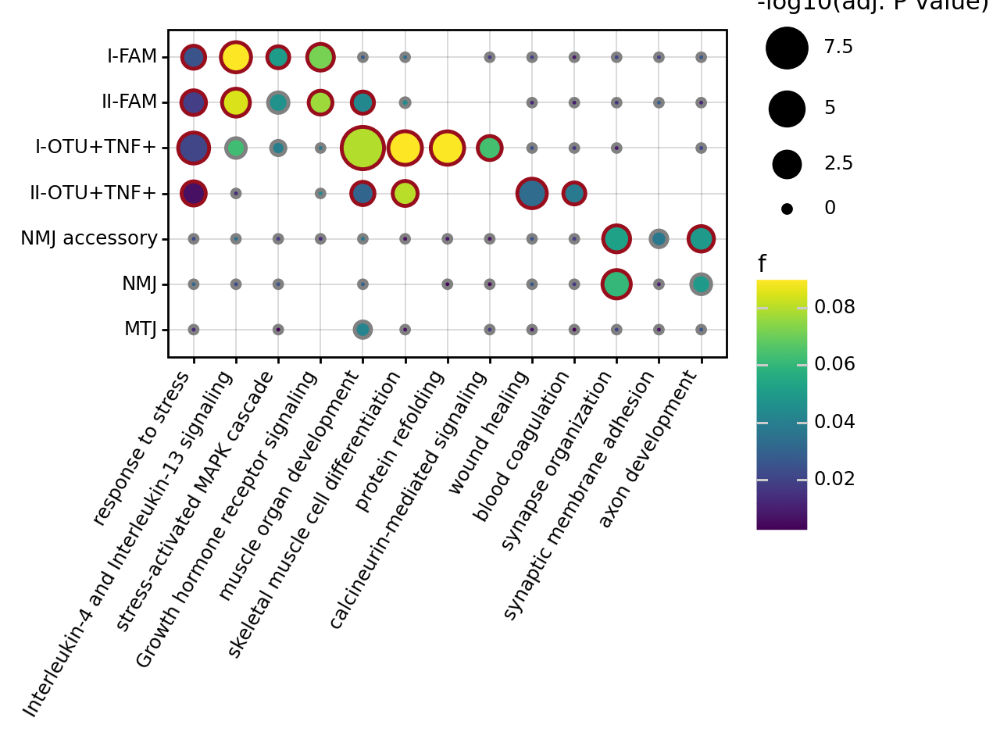

<Figure Size: (640 x 480)>

In [85]:
g2

/nfs/team205/vk8/mambaforge/envs/milopy-env/lib/python3.9/site-packages/plotnine/guides/guide_colorbar.py:73: PlotnineWarning: colorbar guide needs continuous scales


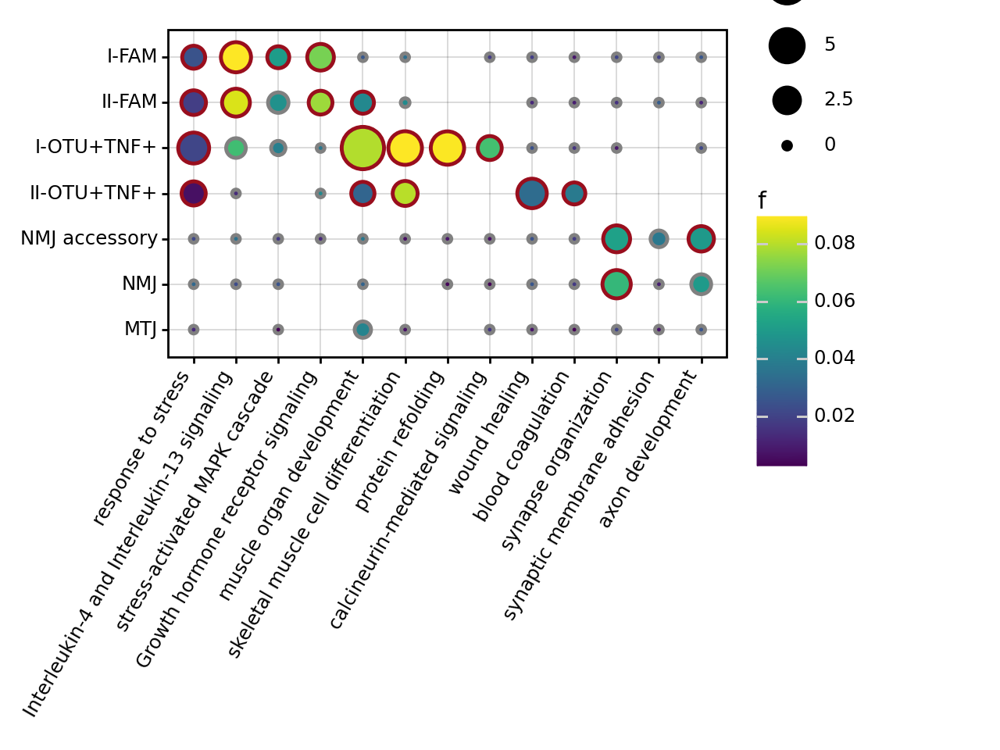

''

In [82]:
str(g2)

In [80]:
g2.save(f"/{figures}/Figure3_enrichments_reanalysis_new.pdf",dpi = 300)

/nfs/team205/vk8/mambaforge/envs/milopy-env/lib/python3.9/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 6.4 x 4.8 in image.
/nfs/team205/vk8/mambaforge/envs/milopy-env/lib/python3.9/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: //nfs/team205/vk8/scripts/scvi/SKM_analyses_rev1/figures/Figure3_enrichments_reanalysis_new.pdf
/nfs/team205/vk8/mambaforge/envs/milopy-env/lib/python3.9/site-packages/plotnine/guides/guide_colorbar.py:73: PlotnineWarning: colorbar guide needs continuous scales


In [24]:
myofiber_clust_enrich_df_sign[(myofiber_clust_enrich_df_sign['query'] == 'II-FAM')&
                             (myofiber_clust_enrich_df_sign['name'] == 'muscle organ development')]['intersections'].tolist()

["['ANKRD1', 'EGR1', 'TNNC1', 'MYL2', 'FOS', 'BTG2', 'CSRP3', 'FLOT1', 'ANKRD2', 'TGFB2']"]

### 5. Plot myonuclei abundance change for major populations and NMJ populations

In [39]:
ctypes2rm = ['Hyb', 'MF-IIsn(fg)', 'MF-Isn(fg)']

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

MF-II_young vs. MF-II_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:4.452e-01 U_stat=1.500e+01
MF-I_young vs. MF-I_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:9.452e-01 U_stat=2.000e+01
I-FAM_young vs. I-FAM_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.128e-02 U_stat=3.500e+01
II-FAM_young vs. II-FAM_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.660e-01 U_stat=2.800e+01
I-OTU+TNF+_young vs. I-OTU+TNF+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:6.282e-01 U_stat=2.500e+01
II-OTU+TNF+_young vs. II-OTU+TNF+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:4.452e-01 U_stat=1.500e+01

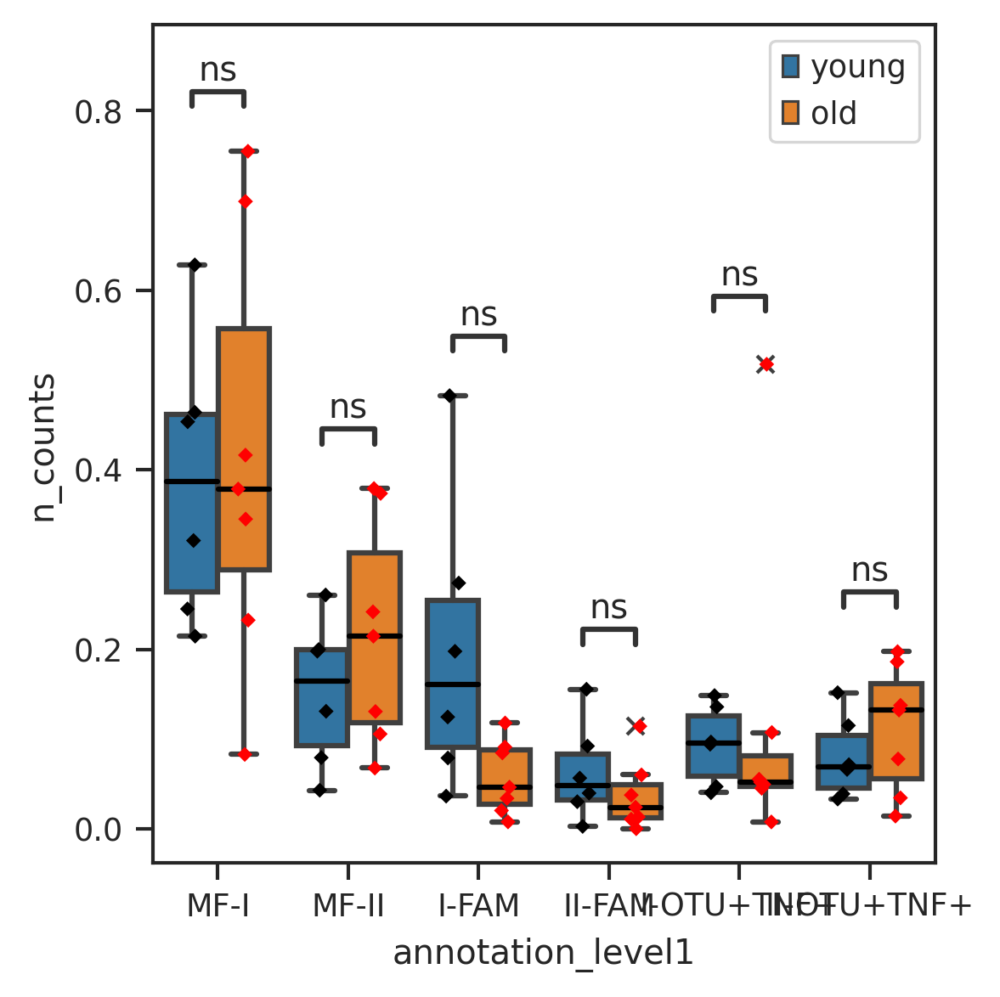

In [50]:
mf_d2ctype_major = calcul_plot_prop_box2(adata_nc, ctype_anno = 'annotation_level1', 
                      sample_anno="SampleID", donor_anno="DonorID", age_group="Age_group", 
                      filt_samples=False, subset_rm=ctypes2rm, 
                                   subset_sel=['MF-I', 'MF-II', 'I-FAM','II-FAM', 'I-OTU+TNF+','II-OTU+TNF+'], pairs=[],
                          plot_save='Myonuclei_major_change', save_dir=figures)

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

NMJ_young vs. NMJ_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:8.357e-01 U_stat=1.900e+01
MTJ_young vs. MTJ_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:9.452e-01 U_stat=2.000e+01
NMJ accessory_young vs. NMJ accessory_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.375e-01 U_stat=1.000e+01


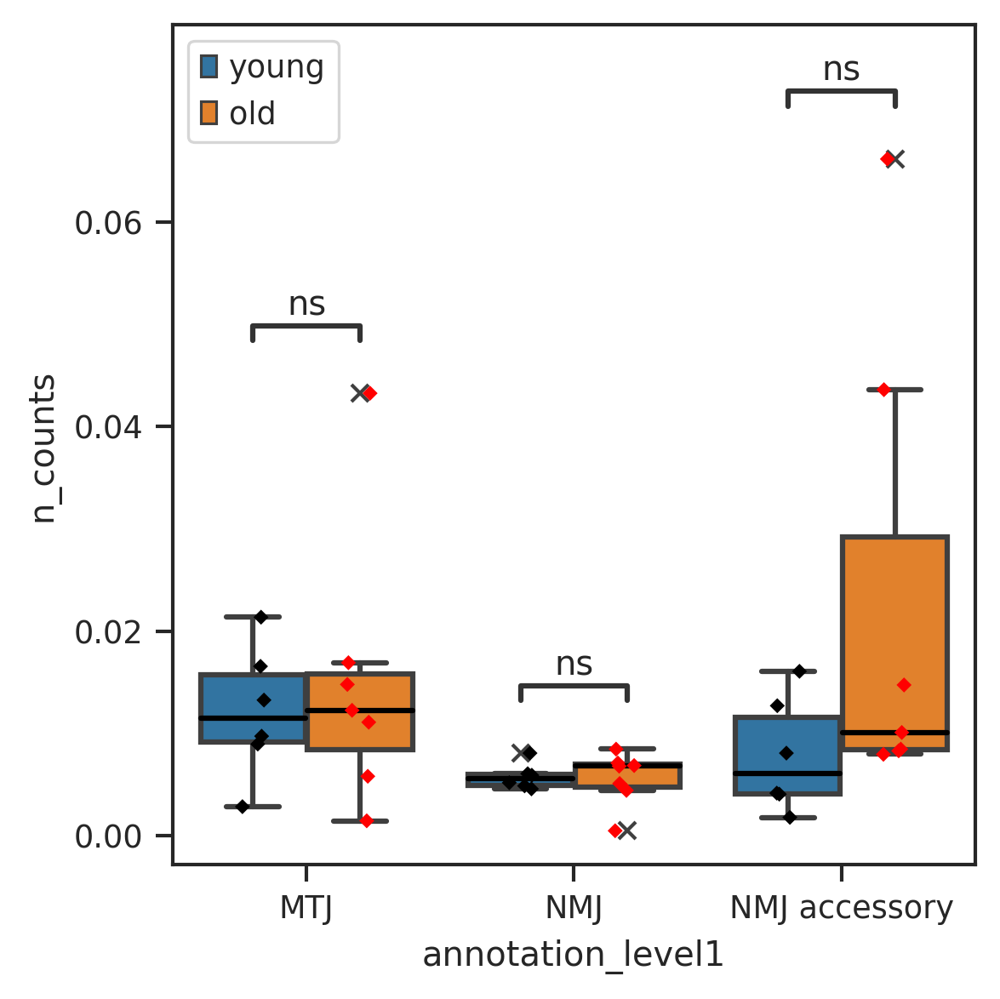

In [51]:
mf_d2ctype_nmj = calcul_plot_prop_box2(adata_nc, ctype_anno = 'annotation_level1', 
                      sample_anno="SampleID", donor_anno="DonorID", age_group="Age_group", 
                      filt_samples=False, subset_rm=ctypes2rm, 
                                   subset_sel=['MTJ', 'NMJ', 'NMJ accessory'], pairs=[],
                          plot_save='Myonuclei_nmj_change', save_dir=figures)

### 6. Update metadata with donor covariates and investigate change in ctype abundance between different covariates

In [58]:
upd_metadata = pd.read_csv("/nfs/team205/vk8/processed_data/muscle/data_v3/SKM_medatada2add_rebuttal.txt", sep = '\t')

subset_meta = upd_metadata[['DonorID', 'Donor_type', 'BMI', 'Ventilation_cat']].copy()
add_meta = pd.DataFrame([['621B', 'DBD', '30-35', 'short'], 
 ['640C', 'DCD', '30-35', 'short']], columns = ['DonorID', 'Donor_type', 'BMI', 'Ventilation_cat'])

subset_meta = pd.concat([subset_meta,add_meta], axis = 0)
subset_meta['BMI'] = subset_meta['BMI'].astype('category')
subset_meta.loc[subset_meta['DonorID'] == '367C', 'BMI'] = '25-30'
subset_meta['BMI_num'] = subset_meta['BMI'].copy()
subset_meta['BMI_num'].cat.categories = [1, 2, 3, 4]
upd_obs = adata_nc.obs.merge(subset_meta, how = "left", left_on = 'DonorID', right_on = 'DonorID').copy()
upd_obs.index = adata_nc.obs.index

In [63]:
adata_nc.obs = upd_obs.copy()

In [67]:
adata_nc.obs['Ventilation_cat'] = adata_nc.obs['Ventilation_cat'].astype('category')

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

MF-II_long vs. MF-II_short: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.035e-01 U_stat=1.300e+01
MF-I_long vs. MF-I_short: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:9.399e-01 U_stat=1.700e+01
I-FAM_long vs. I-FAM_short: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.035e-01 U_stat=2.300e+01
II-FAM_long vs. II-FAM_short: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:9.399e-01 U_stat=1.900e+01
I-OTU+TNF+_long vs. I-OTU+TNF+_short: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:4.140e-01 U_stat=1.200e+01
II-OTU+TNF+_long vs. II-OTU+TNF+_short: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.063e-01 U_stat=7.0

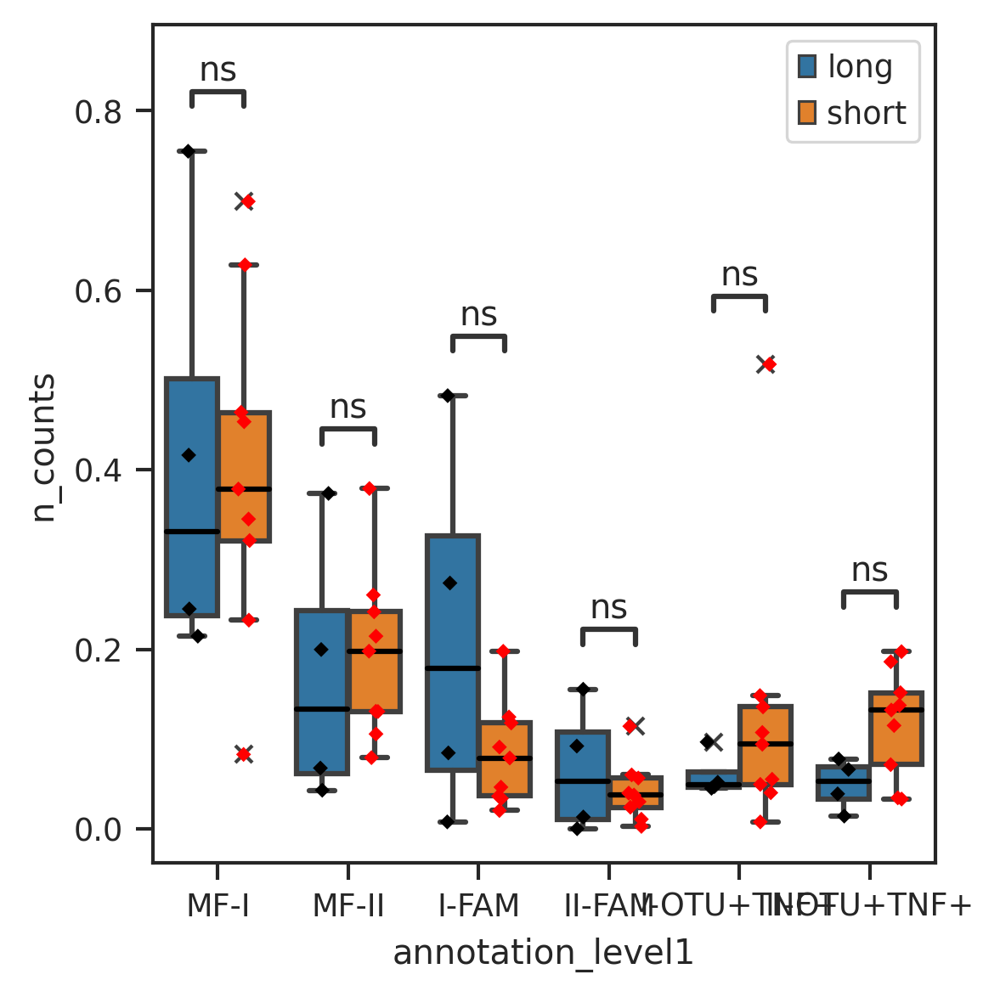

In [68]:
mf_d2ctype_vent = calcul_plot_prop_box2(adata_nc, ctype_anno = 'annotation_level1', 
                      sample_anno="SampleID", donor_anno="DonorID", age_group='Ventilation_cat', 
                      filt_samples=False, subset_rm=ctypes2rm, 
                                   subset_sel=['MF-I', 'MF-II', 'I-FAM','II-FAM', 'I-OTU+TNF+','II-OTU+TNF+'], pairs=[],
                          plot_save='Myonuclei_major_change_venitlation.pdf', save_dir=figures)

In [69]:
adata_nc.obs.columns

Index(['SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age',
       'Species', 'Operator', 'Sample', '10X_version', 'n_counts',
       'n_counts_raw', 'percent_soup', 'n_counts_spliced',
       'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito',
       'percent_ribo', 'percent_hb', 'Age_group', 'scrublet_score',
       'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score',
       'G2M_score', 'phase', 'leiden', 'fine_predicted_labels',
       'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score',
       'coarse_predicted_labels', 'coarse_over_clustering',
       'coarse_majority_voting', 'coarse_conf_score', 'leiden_r1.6',
       'leiden_r2', 'leiden_r3', 'leiden_r', 'manual_anno',
       'myofiber_fine_predicted_labels', 'myofiber_fine_over_clustering',
       'myofiber_fine_majority_voting', 'myofiber_fine_conf_score',
       'manual_anno2', 'annotation_level0', 'annotation_level1', 'MYH7+',
       'MYH1+', 'MYH2+', 'myofiber_type', 'm

In [71]:
adata_nc.obs['Donor_type'] = adata_nc.obs['Donor_type'].astype('category')

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

MF-II_DBD vs. MF-II_DCD: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.949e-01 U_stat=1.300e+01
MF-I_DBD vs. MF-I_DCD: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:4.452e-01 U_stat=1.500e+01
I-FAM_DBD vs. I-FAM_DCD: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:6.282e-01 U_stat=2.500e+01
II-FAM_DBD vs. II-FAM_DCD: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:4.452e-01 U_stat=2.700e+01
I-OTU+TNF+_DBD vs. I-OTU+TNF+_DCD: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:8.357e-01 U_stat=1.900e+01
II-OTU+TNF+_DBD vs. II-OTU+TNF+_DCD: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:8.357e-01 U_stat=2.300e+01


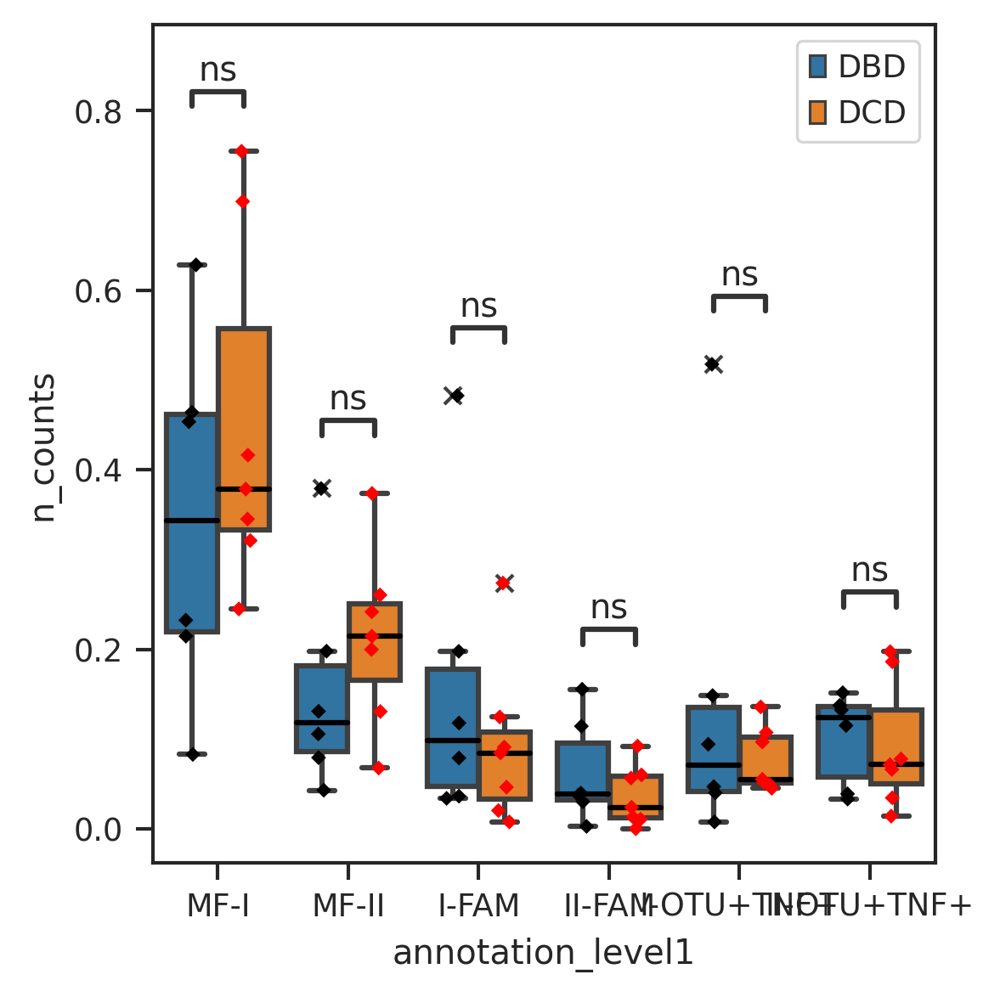

In [72]:
mf_d2ctype_dtype = calcul_plot_prop_box2(adata_nc, ctype_anno = 'annotation_level1', 
                      sample_anno="SampleID", donor_anno="DonorID", age_group='Donor_type', 
                      filt_samples=False, subset_rm=ctypes2rm, 
                                   subset_sel=['MF-I', 'MF-II', 'I-FAM','II-FAM', 'I-OTU+TNF+','II-OTU+TNF+'], pairs=[],
                          plot_save='Myonuclei_major_change_venitlation.pdf', save_dir=figures)

### 7. Save stripped adata version for Milo analysis 

In [82]:
adata_diet = sc.AnnData(X = adata_nc.X, obs = adata_nc.obs, var = adata_nc.var, obsm = adata_nc.obsm )

In [84]:
adata_diet.write(f'/nfs/team205/vk8/processed_data/muscle/data_v3/updated_icm_snuclei/ICM_myonuclei_scvi1_dbrm_diet_{today}.h5ad')

### 8. Plot cell type distribution in Perez data

In [4]:
adata_pz = sc.read("/nfs/team205/vk8/processed_data/muscle/data_v3/SKM_nuclei_Perez2022_raw_scvi2_annot_dbrm_2023-05-05.h5ad")

In [5]:
adata_pz.obs

,SampleID,barcode,concat_sample_no,Sample,Batch,Age_group,Tissue,Age,Filename,n_counts,n_counts_raw,percent_soup,n_counts_spliced,n_counts_unspliced,percent_spliced,n_genes,percent_mito,percent_ribo,percent_hb,scrublet_score,scrublet_cluster_score,bh_pval,is_doublet,S_score,G2M_score,phase,leiden,leiden_r1.6,leiden_r2,leiden_r3,fine_predicted_labels,fine_over_clustering,fine_majority_voting,fine_conf_score,coarse_predicted_labels,coarse_over_clustering,coarse_majority_voting,coarse_conf_score,leiden_r,manual_anno,fine2_predicted_labels,fine2_over_clustering,fine2_majority_voting,fine2_conf_score,coarse2_predicted_labels,coarse2_over_clustering,coarse2_majority_voting,coarse2_conf_score,HMX_exprs,manual_anno2
GSM5098753-TATGCCCGTAAGCACG,GSM5098753,TATGCCCGTAAGCACG,16,HM23,Single-nuclei RNA-seq,old,Skeletal muscle,90,GSM5098753_HM23.csv.gz,7991.0,8709.0,8.244348,2544.0,5378.0,32.113102,2624,0.000125,0.000125,0.000125,0.021345,0.027875,0.916830,False,0.034003,-0.153551,S,9,14,45,22,Hyb,77,MF-I,0.351375,MF_typeI,77,MF_typeI,0.999148,45,MF-I,Hyb,43,MF-I,0.351375,MF_typeI,43,MF_typeI,0.999148,False,MF-I
GSM5098743-CGTTCTGGTGTGACGA,GSM5098743,CGTTCTGGTGTGACGA,6,HM7,Single-nuclei RNA-seq,old,Skeletal muscle,72,GSM5098743_HM7.csv.gz,1564.0,1694.0,7.674146,837.0,758.0,52.476490,928,0.000000,0.000000,0.000000,0.059578,0.061453,0.806688,False,-0.104751,-0.085481,G1,2,3,3,27,Hyb,311,MF-I,0.792837,MF_typeI,311,MF_typeI,0.903264,3,MF-I,Hyb,211,MF-I,0.792837,MF_typeI,211,MF_typeI,0.903264,False,MF-I
GSM5098752-AGTGAGGTCAGCACAT,GSM5098752,AGTGAGGTCAGCACAT,15,HM22,Single-nuclei RNA-seq,young,Skeletal muscle,21,GSM5098752_HM22.csv.gz,4431.0,4931.0,10.139931,958.0,3710.0,20.522707,1971,0.000000,0.000000,0.000000,0.109420,0.073134,0.992820,False,-0.045393,-0.025760,G1,0,0,0,26,Hyb,329,MF-II,0.983089,MF_typeII,329,MF_typeII,0.999506,0,MF-II,Hyb,507,MF-II,0.983089,MF_typeII,507,MF_typeII,0.999506,False,MF-II
GSM5098752-TCTCTAATCATTCACT,GSM5098752,TCTCTAATCATTCACT,15,HM22,Single-nuclei RNA-seq,young,Skeletal muscle,21,GSM5098752_HM22.csv.gz,5502.0,6147.0,10.492921,1153.0,4559.0,20.185575,2303,0.000000,0.000000,0.000182,0.096831,0.141884,0.909516,False,0.190323,-0.058846,S,5,12,0,11,II-OTU+TNF+,124,MF-II,0.105597,MF_typeII,124,MF_typeII,0.987495,0,MF-II,II-OTU+TNF+,617,MF-II,0.105597,MF_typeII,617,MF_typeII,0.987495,False,MF-II
GSM5098745-TGGCGCAGTCTACCTC,GSM5098745,TGGCGCAGTCTACCTC,8,HM9,Single-nuclei RNA-seq,old,Skeletal muscle,70,GSM5098745_HM9.csv.gz,1794.0,2043.0,12.187958,666.0,1309.0,33.721519,1181,0.000000,0.000000,0.000000,0.078125,0.012146,0.952057,False,-0.142772,-0.119241,G1,11,19,38,33,SMC,125,SMC,0.876017,SMC,125,SMC,0.947937,38,SMC,SMC,101,Pericyte,0.876017,SMC,101,Pericyte,0.947937,False,Pericyte
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM5098745-AGGTCCGGTGTGCGTC,GSM5098745,AGGTCCGGTGTGCGTC,8,HM9,Single-nuclei RNA-seq,old,Skeletal muscle,70,GSM5098745_HM9.csv.gz,2520.0,2729.0,7.658482,855.0,1721.0,33.190994,1416,0.000000,0.000000,0.000794,0.006639,0.012146,0.952057,False,-0.183059,0.096459,G2M,4,6,"4,0",4,FB,22,FB,0.999984,FB,22,FB,0.999871,4,FB,FB,14,FB,0.999984,FB,14,FB,0.999871,False,FB
GSM5098741-GCATGATTCTGATACG,GSM5098741,GCATGATTCTGATACG,4,HM5,Single-nuclei RNA-seq,young,Skeletal muscle,20,GSM5098741_HM5.csv.gz,5230.0,5585.0,6.356311,1487.0,3802.0,28.114956,2097,0.000000,0.000000,0.000191,0.109890,0.132193,0.844724,False,0.042605,-0.063256,S,3,1,2,2,MF-II,589,MF-II,0.029783,MF_typeII,589,MF_typeII,0.991239,2,MF-II,MF-II,284,MF-II,0.029783,MF_typeII,284,MF_typeII,0.991239,False,MF-II
GSM5098742-AGAGCGAGTCGGCTCA,GSM5098742,AGAGCGAGTCGGCTCA,5,HM6,Single-nuclei RNA-seq,old,Skeletal muscle,82,GSM5098742_HM6.csv.gz,884.0,965.0,8.393783,481.0,429.0,52.857143,626,0.000000,0.000000,0.000000,0.108491,0.084141,0.908439,False,-0.066496,-0.018403,G1,2,4,"1,0",35,MF-I,578,MF-I,0.11

In [7]:
adata_pz.X.data

array([0.81155574, 0.81155574, 1.2535671 , ..., 1.4720037 , 2.4045887 ,
       1.4720037 ], dtype=float32)

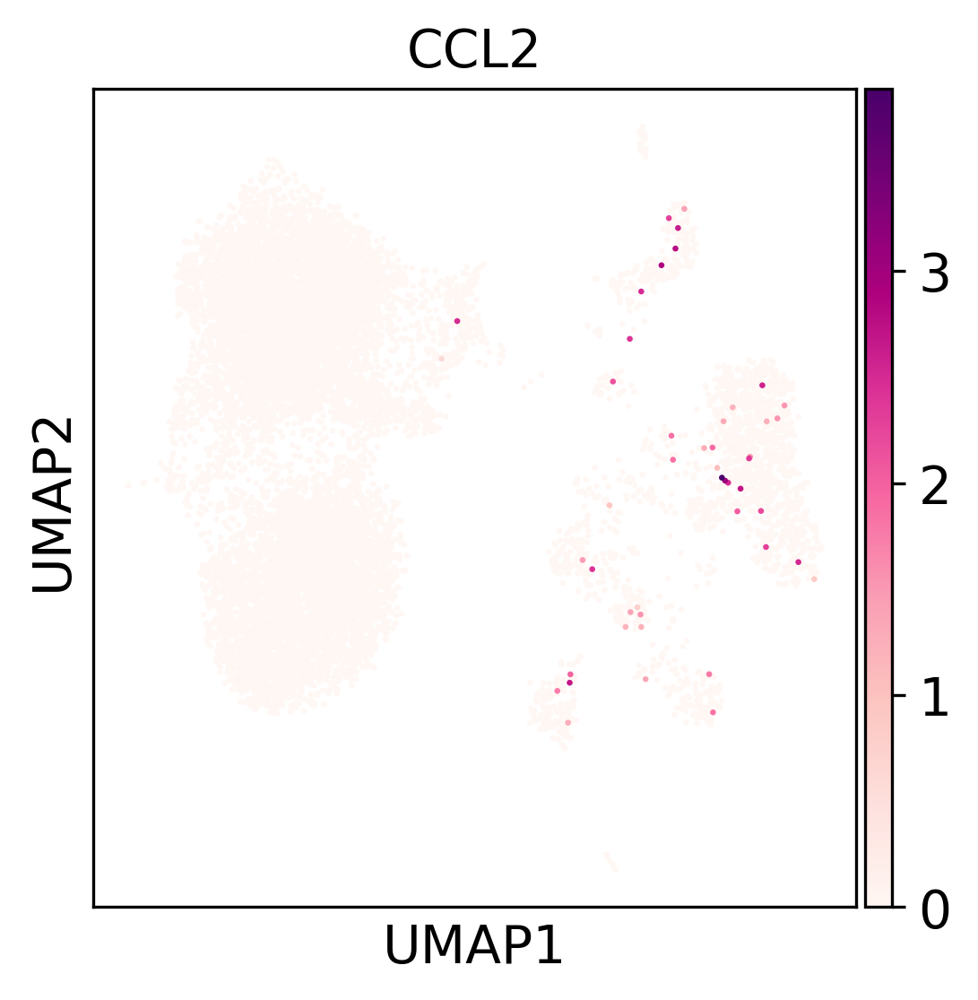

In [6]:
sc.pl.umap(adata_pz, color = "CCL2")

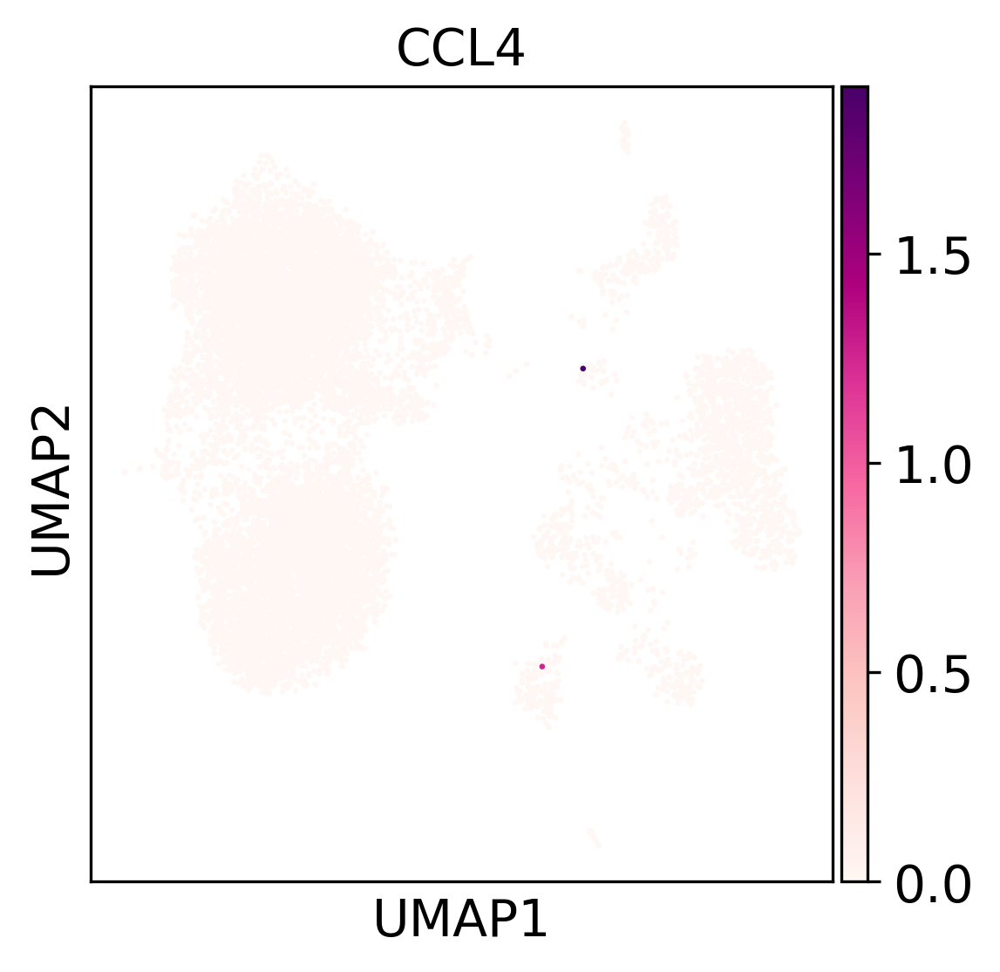

In [8]:
sc.pl.umap(adata_pz, color = "CCL4")

In [14]:
adata_pz.obs[['SampleID', 'barcode', 'Age', 'Age_group', 'Batch', 'manual_anno2']].to_csv("/nfs/team205/vk8/bds3/Perez_2022_cell_type_counts.csv")

In [15]:
adata_pz

AnnData object with n_obs × n_vars = 103932 × 33538
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'Sample', 'Batch', 'Age_group', 'Tissue', 'Age', 'Filename', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'leiden', 'leiden_r1.6', 'leiden_r2', 'leiden_r3', 'fine_predicted_labels', 'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score', 'coarse_predicted_labels', 'coarse_over_clustering', 'coarse_majority_voting', 'coarse_conf_score', 'leiden_r', 'manual_anno', 'fine2_predicted_labels', 'fine2_over_clustering', 'fine2_majority_voting', 'fine2_conf_score', 'coarse2_predicted_labels', 'coarse2_over_clustering', 'coarse2_majority_voting', 'coarse2_conf_score', 'HMX_exprs', 'manual_anno2'
    var: 'ENSEMBL', 'feature_types', 'genome', 'SYMBOL', 'n_counts', 'n_c

In [16]:
adata_pz.shape

(103932, 33538)

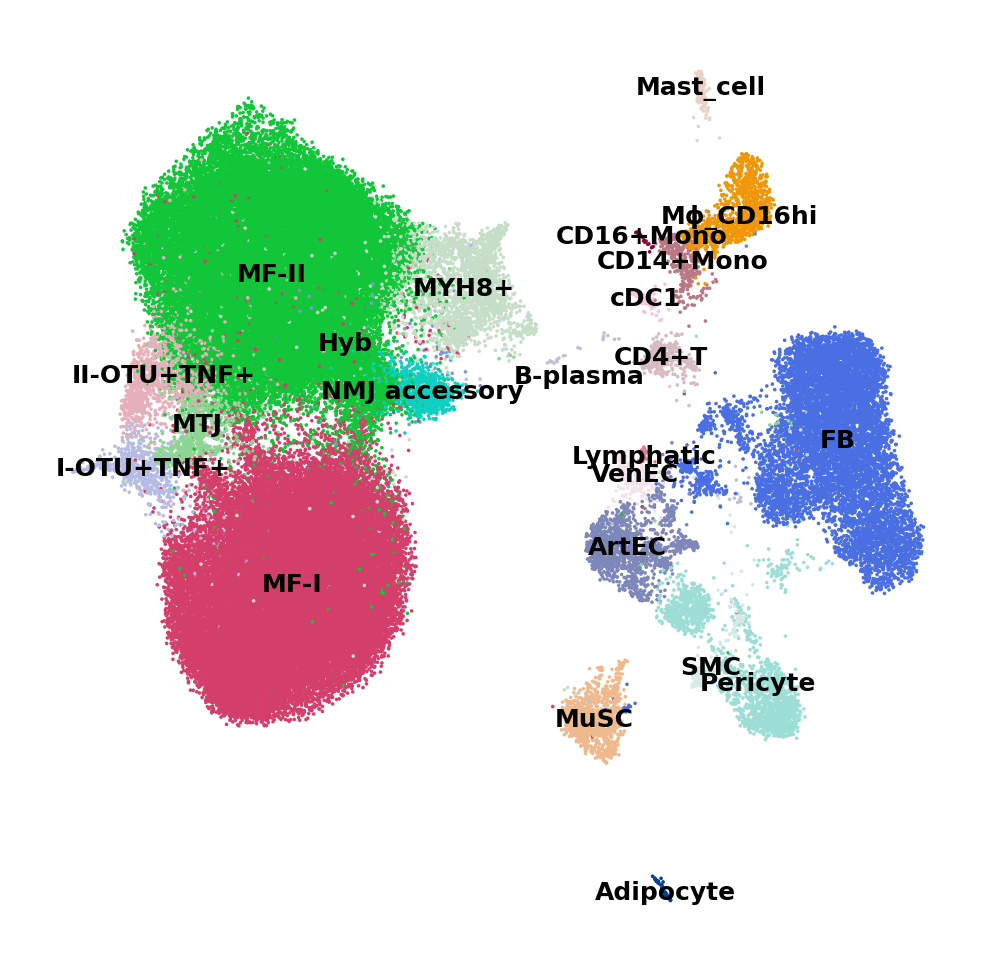

In [8]:
sc.pl.umap(adata_pz, color = ['manual_anno2'], legend_loc = "on data", legend_fontsize = 6, s = 3, 
          frameon = False, title = "", save = f"Myofiber_nuclei_perez_{today}.pdf")

In [17]:
adata_pz_ss = sc.pp.subsample(adata_pz, n_obs=12000, copy=False)

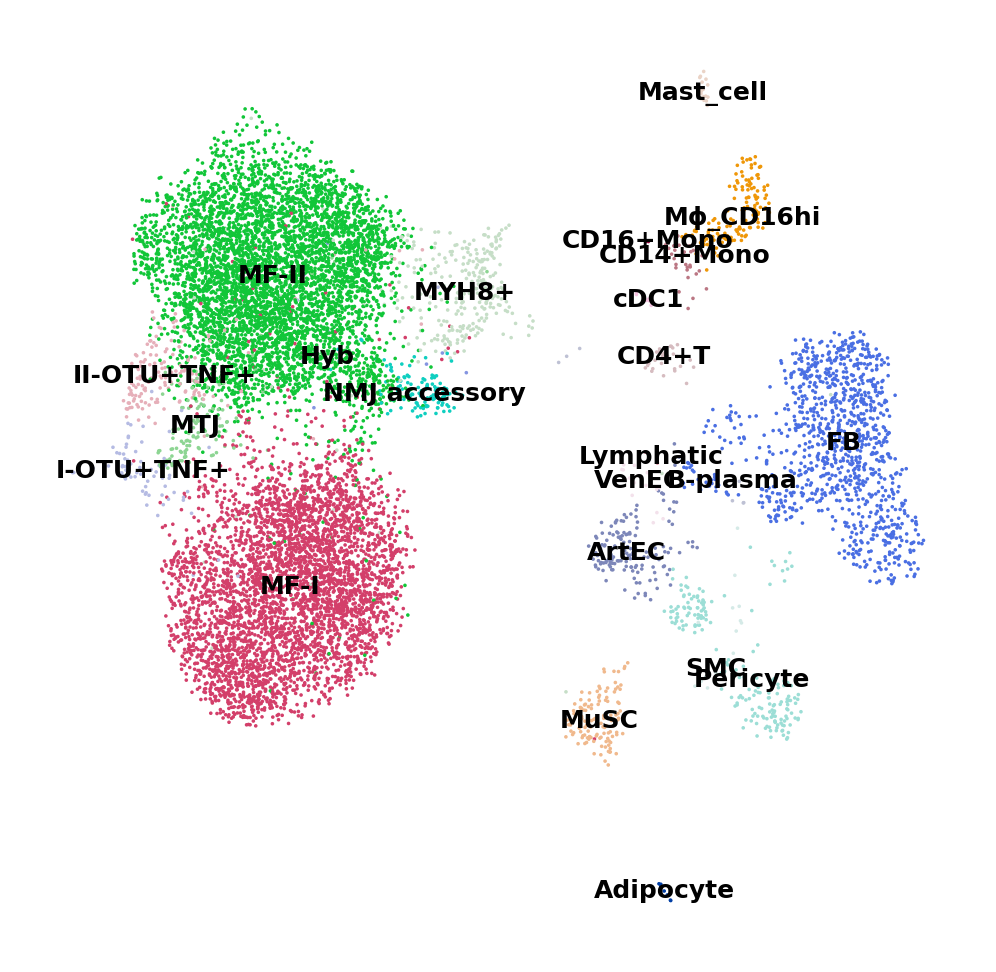

In [20]:
sc.pl.umap(adata_pz, color = ['manual_anno2'], legend_loc = "on data", legend_fontsize = 6, s = 3, 
          frameon = False, title = "")

In [24]:
adata_pz.write('/nfs/team205/vk8/bds3/Perez_2022_scell.h5ad')

In [25]:
adata_pz

AnnData object with n_obs × n_vars = 12000 × 33538
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'Sample', 'Batch', 'Age_group', 'Tissue', 'Age', 'Filename', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'leiden', 'leiden_r1.6', 'leiden_r2', 'leiden_r3', 'fine_predicted_labels', 'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score', 'coarse_predicted_labels', 'coarse_over_clustering', 'coarse_majority_voting', 'coarse_conf_score', 'leiden_r', 'manual_anno', 'fine2_predicted_labels', 'fine2_over_clustering', 'fine2_majority_voting', 'fine2_conf_score', 'coarse2_predicted_labels', 'coarse2_over_clustering', 'coarse2_majority_voting', 'coarse2_conf_score', 'HMX_exprs', 'manual_anno2'
    var: 'ENSEMBL', 'feature_types', 'genome', 'SYMBOL', 'n_counts', 'n_ce

In [61]:
myofiber_mrkrs = ['TNNT1', 'MYH7', 'TNNT3', 'MYH1', 'MYH2', 
                 "CKM", "MB", "COX6C", # cytoplasmic populations
                'FAM189A2', 'KHDRBS3','NAMPT', 'SOCS3', 'STAT3', # FAM189A2 population
                'OTUD1','CREB5', 'ATF3', 'XIRP1','ENAH', 'FLNC', 'DNAJA4', #'BDNF',  # 'NRAP', 'ANKRD1', 'XIRP2',  # OTUD1 population 
                    'TNFRSF12A',
                   'MUSK', 'ACHE', 'VMO1', 'PLCB4',  #NMJ
                    'NCAM1', 'MAML2', 'SNX7', # MTJ
                 'SORBS2', 'EFNA5', 'BMPR1B', 'GRIA2', 'STYK1', # SORBS2 population
                   'ACTC1', 'UCHL1', 'RGCC', 'MLLT11', # UCHL1 population
                    'MYOG', 'TNNT2', # TNNT2 population
                     'CDKN1A', 'ADIRF', 'SAA1',  'MYH8', # MYH8 populations 'MYOD1',
                   'FLCN', 'FNIP1', 'RASA4']

In [62]:
myofiber_mrkrs_pz = ['TNNT1', 'MYH7', 'TNNT3', 'MYH1', 'MYH2', 
                     'OTUD1','CREB5', 'ATF3', 'XIRP1','ENAH', 'FLNC', 'DNAJA4', #'BDNF',  # 'NRAP', 'ANKRD1', 'XIRP2',  # OTUD1 population 
                    'TNFRSF12A', #'THBD','JUNB', 'JDP2', 'ERCC1','GADD45A','ANXA5',
                      'CDKN1A', 'ADIRF', 'MYH8', #'SAA1',  'MYH8', # MYH8 populations 'MYOD1',
                     'NCAM1', 'MAML2', 'SNX7', # MTJ
                 'SORBS2', 'EFNA5', 'BMPR1B', 'GRIA2', 'STYK1', # SORBS2 population
                   ]

In [63]:
mf_ctypes_pz = ['MF-I', 'MF-II', 'I-OTU+TNF+', 'II-OTU+TNF+', 'MYH8+', 'MTJ', 'NMJ accessory'] 

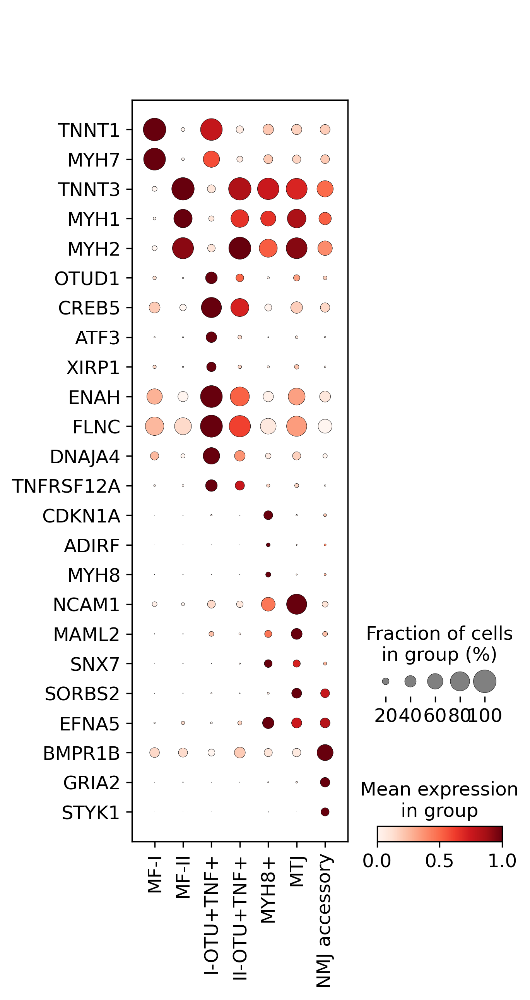

In [111]:
sc.pl.dotplot(adata_pz[adata_pz.obs['manual_anno2'].isin(mf_ctypes_pz),:], var_names = myofiber_mrkrs_pz, groupby = 'manual_anno2',
             categories_order = mf_ctypes_pz, standard_scale = "var", save = "Perez_myofiber_nuclei.pdf", 
              swap_axes=True)

In [8]:
adata_pz.obs['Age_group'] = adata_pz.obs['Age_group'].cat.reorder_categories(['young', 'old'])

In [17]:
adata_pz.obs.groupby(['Sample', 'Age_group'], observed = True).count().sort_values('Age_group')

,,SampleID,barcode,concat_sample_no,Batch,Tissue,Age,Filename,n_counts,n_counts_raw,percent_soup,n_counts_spliced,n_counts_unspliced,percent_spliced,n_genes,percent_mito,percent_ribo,percent_hb,scrublet_score,scrublet_cluster_score,bh_pval,is_doublet,S_score,G2M_score,phase,leiden,leiden_r1.6,leiden_r2,leiden_r3,fine_predicted_labels,fine_over_clustering,fine_majority_voting,fine_conf_score,coarse_predicted_labels,coarse_over_clustering,coarse_majority_voting,coarse_conf_score,leiden_r,manual_anno,fine2_predicted_labels,fine2_over_clustering,fine2_majority_voting,fine2_conf_score,coarse2_predicted_labels,coarse2_over_clustering,coarse2_majority_voting,coarse2_conf_score,HMX_exprs,manual_anno2
Sample,Age_group,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
HM21,young,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186,9186
HM13,young,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982,2982
HM5,young,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113,5113
HM8,young,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119,5119
HM22,young,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975,9975
HM10,young,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419,4419
HM1,old,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243,5243
HM15,old,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085,3085
HM12,old,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932,4932


In [11]:
pz_d2ctype_dtype['df']['a']

,Age_group,Sample,manual_anno2,n_counts
0,old,HM1,MF-I,0.351707
1,old,HM1,MF-II,0.318711
2,old,HM1,I-OTU+TNF+,0.000191
3,old,HM1,II-OTU+TNF+,0.008011
4,old,HM1,MYH8+,0.075720
...,...,...,...,...
114,old,HM23,I-OTU+TNF+,0.003344
115,old,HM23,II-OTU+TNF+,0.025043
116,old,HM23,MYH8+,0.076917
117,old,HM23,MTJ,0.015010


/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

MF-II_old vs. MF-II_young: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.215e-01 U_stat=1.700e+01
MF-I_old vs. MF-I_young: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.161e-01 U_stat=4.600e+01
I-OTU+TNF+_old vs. I-OTU+TNF+_young: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.385e-01 U_stat=4.300e+01
II-OTU+TNF+_old vs. II-OTU+TNF+_young: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.133e-01 U_stat=4.000e+01
MYH8+_old vs. MYH8+_young: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.939e-03 U_stat=6.200e+01
MTJ_old vs. MTJ_young: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.731e-02 (ns) U_stat=1.100e+01


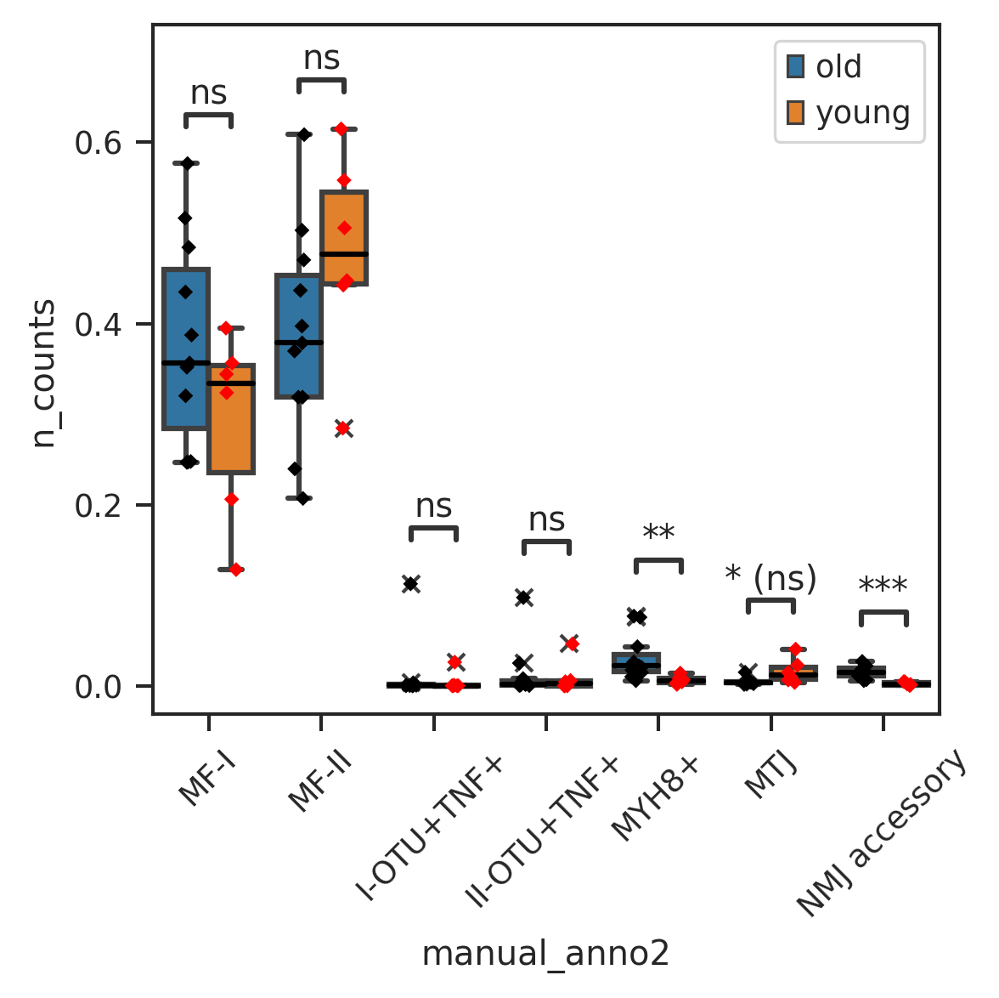

In [26]:
pz_d2ctype_dtype = calcul_plot_prop_box2(adata_pz, ctype_anno = 'manual_anno2', 
                      sample_anno="SampleID", donor_anno="Sample", age_group='Age_group', 
                      filt_samples=False, 
                                   subset_sel=['MF-I', 'MF-II', 'I-OTU+TNF+', 'II-OTU+TNF+', 'MYH8+', 'MTJ', 'NMJ accessory'] , pairs=[],
                          plot_save='Myonuclei_abund_change_pz.pdf', save_dir=figures)

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

II-OTU+TNF+_young vs. II-OTU+TNF+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.133e-01 U_stat=2.600e+01
I-OTU+TNF+_young vs. I-OTU+TNF+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.385e-01 U_stat=2.300e+01
MYH8+_young vs. MYH8+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.939e-03 U_stat=4.000e+00
MTJ_young vs. MTJ_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.731e-02 U_stat=5.500e+01
NMJ accessory_young vs. NMJ accessory_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.616e-04 U_stat=0.000e+00


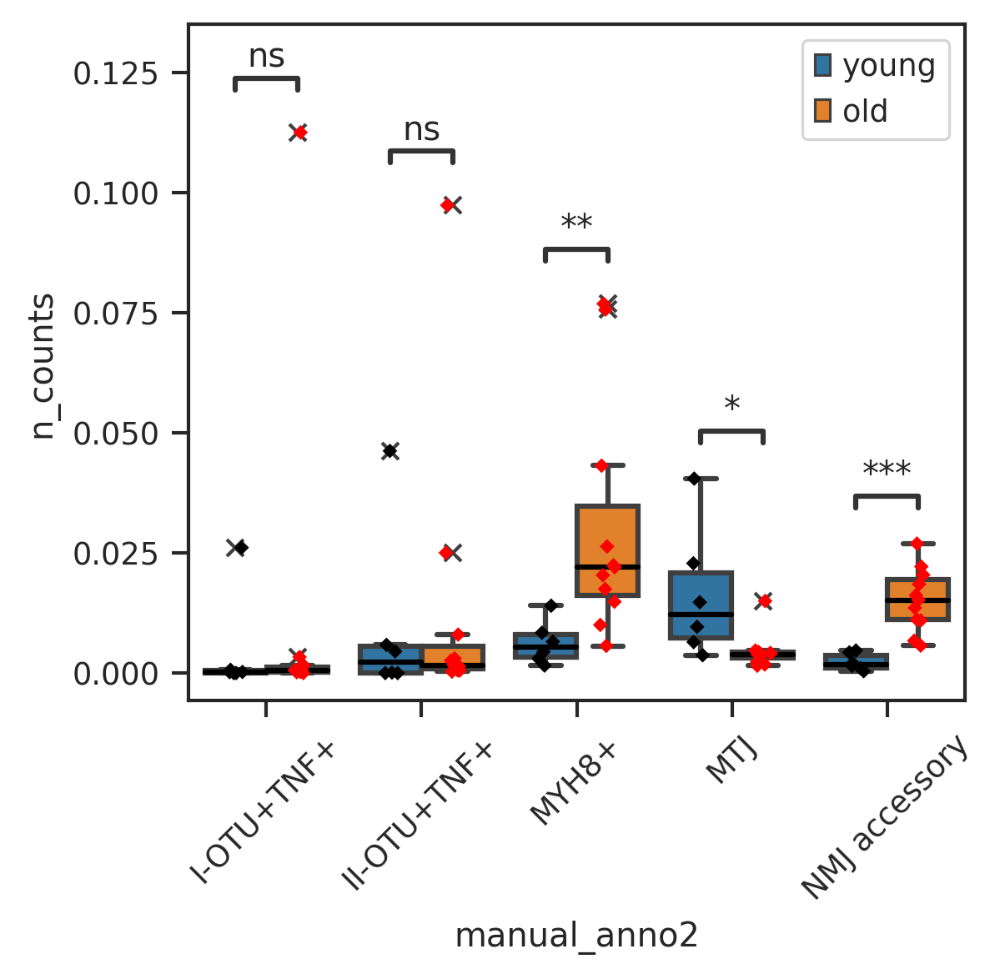

In [68]:
pz_d2ctype_dtype = calcul_plot_prop_box2(adata_pz, ctype_anno = 'manual_anno2', 
                      sample_anno="SampleID", donor_anno="Sample", age_group='Age_group', 
                      filt_samples=False, 
                                   subset_sel=['I-OTU+TNF+', 'II-OTU+TNF+', 'MYH8+', 'MTJ', 'NMJ accessory'] , pairs=[],
                          plot_save='Myonuclei_abund_change_subset_pz.pdf', save_dir=figures)

### 9. Plot distribution of myonuclei type populations

In [9]:
adata_nc

AnnData object with n_obs × n_vars = 74626 × 33538
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', '10X_version', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'Age_group', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'leiden', 'fine_predicted_labels', 'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score', 'coarse_predicted_labels', 'coarse_over_clustering', 'coarse_majority_voting', 'coarse_conf_score', 'leiden_r1.6', 'leiden_r2', 'leiden_r3', 'leiden_r', 'manual_anno', 'myofiber_fine_predicted_labels', 'myofiber_fine_over_clustering', 'myofiber_fine_majority_voting', 'myofiber_fine_conf_score', 'manual_anno2', 'annotation_level0', 'annotation_level1', 'MYH7+', 'MYH1+', 'MYH2+', 'myofiber_type', 'myofiber_type_filt'
    var: 'ENSEMBL', 'SYMBO

In [10]:
adata_nc.obs['MYH7+'] = adata_nc[:,'MYH7'].X.todense()>0
adata_nc.obs['MYH1+'] = adata_nc[:,'MYH1'].X.todense()>0
adata_nc.obs['MYH2+'] = adata_nc[:,'MYH2'].X.todense()>0
adata_nc.obs['myofiber_type2'] = adata_nc.obs.\
apply(lambda x: 'MYH7+' if (x['MYH7+'] == True) & (x['MYH1+'] == False) & (x['MYH2+'] == False) else
      'MYH1+' if  (x['MYH7+'] == False) & (x['MYH1+'] == True) & (x['MYH2+'] == False) else
 'MYH2+' if  (x['MYH7+'] == False) & (x['MYH1+'] == False) & (x['MYH2+'] == True) else
    'MYH1+MYH2+' if (x['MYH7+'] == False) & (x['MYH1+'] == True) & (x['MYH2+'] == True) else
     'MYH1+MYH7+' if (x['MYH7+'] == True) & (x['MYH1+'] == True) & (x['MYH2+'] == False) else 
      'MYH2+MYH7+' if (x['MYH7+'] == True) & (x['MYH2+'] == True) & (x['MYH1+'] == False) else
      'MYH1+MYH2+MYH7+' if (x['MYH7+'] == True) & (x['MYH2+'] == True) & (x['MYH1+'] == True) else
      'nan', axis = 1)

In [11]:
adata_nc.obs.groupby(['DonorID', 'SampleID', '10X_version'], observed = True).mean()[['n_counts', 'n_genes']].sort_values('n_counts')

n_counts      n_genes
DonorID SampleID         10X_version                          
582C    WS_A_SKM10691779 3'v3          876.735535   530.267218
500C    5386STDY8493510  3'v2          966.959717   588.431699
470BR   5386STDY8090406  3'v2         1145.684692   675.436788
        5386STDY8090407  3'v2         1170.703247   695.483357
398B    5386STDY7796287  3'v2         1199.798950   633.969072
        5386STDY7796286  3'v2         1206.961792   658.289617
362C    5386STDY7600837  3'v2         1359.044312   708.056449
367C    5386STDY7645355  3'v2         1408.261108   770.810401
583B    WS_A_SKM10691778 3'v3         1421.940430   726.084541
362C    5386STDY7600836  3'v2         1439.570557   732.884615
566B    WS_A_SKM9426500  3'v3         1952.177612  1036.377532
339C    mus_SNuc7468111  3'v2         2252.446777   944.175582
362C    WS_A_SKM9426496  3'v3         2297.555908  1103.584094
464C    5386STDY8552614  3'v2/v3      2526.824951  1147.665929
        5386STDY8552613  3'v2/v3      2534.495850  1146.447641
502B    WS_A_SKM9426495  3'v3         2982.423096  1113.565916
470BR   5386STDY8552709  3'v2/v3      3028.176514  1223.699746
529C    WS_A_SKM9426501  3'v3         3539.259766  1460.576263
        WS_A_SKM9426502  3'v3         3599.880371  1466.671276
343B    WS_A_SKM9426497  3'v3         4061.525879  1167.568038
        WS_A_SKM9426498  3'v3         4130.879395  1180.887079
566B    WS_A_SKM9426499  3'v3         9024.173828  2807.559229

In [12]:
pd.crosstab(adata_nc.obs['myofiber_type2'], adata_nc.obs['myofiber_type'])

myofiber_type,MYH1+,MYH2+,MYH1+MYH2+,MYH7+,MYH1+MYH7+,MYH2+MYH7+,MYH1+MYH2+MYH7+,nan
myofiber_type2,,,,,,,,
MYH1+,5087,0,0,0,0,0,0,3
MYH1+MYH2+,0,1,3197,0,0,0,0,2
MYH1+MYH2+MYH7+,1,0,0,1,0,2,362,0
MYH1+MYH7+,0,0,0,3,689,0,0,1
MYH2+,0,3943,0,0,0,0,0,0
MYH2+MYH7+,0,0,0,5,0,950,0,0
MYH7+,0,0,0,25133,0,0,0,2
nan,0,0,0,0,0,0,0,35244


In [13]:
adata_nc.obs['myofiber_type'] = adata_nc.obs['myofiber_type'].cat.reorder_categories(new_categories = ['MYH7+', 'MYH2+', 'MYH1+', 'MYH1+MYH2+', 'MYH2+MYH7+', 'MYH1+MYH7+',\
                                                                   'MYH1+MYH2+MYH7+', 'nan']).copy()
adata_nc.uns['myofiber_type_colors'] = ['#1E88E5', '#00FF66', '#F44336', '#FFFF00', '#00796B', '#6C3483', '#BDBDBD', '#b5bd61']

In [14]:
adata_nc.obs['myofiber_type_filt'] = adata_nc.obs['myofiber_type_filt'].cat.reorder_categories(new_categories = ['MYH7+', 'MYH2+', 'MYH1+', 'MYH1+MYH2+', 'MYH2+MYH7+', 'MYH1+MYH7+',\
                                                                   'MYH1+MYH2+MYH7+', 'nan']).copy()
#adata_nc.uns['myofiber_type_colors'] = ['#1E88E5', '#00FF66', '#F44336', '#FFFF00', '#00796B', '#6C3483', '#BDBDBD', '#b5bd61']

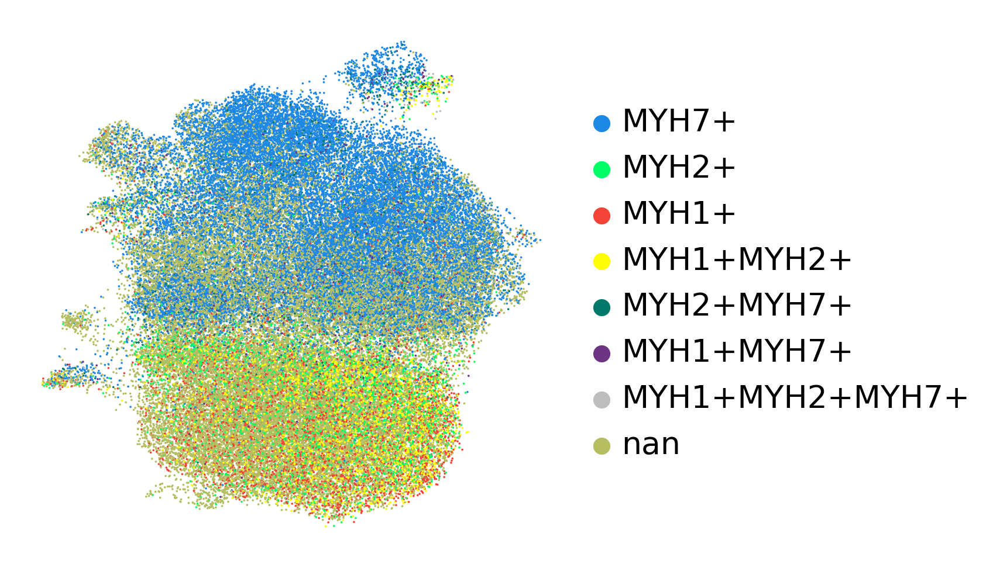

In [46]:
sc.pl.umap(adata_nc, color = ['myofiber_type'], s = 3, 
          frameon = False, title = "", save = f"Myofiber_nuclei_MYH_types_{today}.pdf")

In [14]:
adata_nc_filt = adata_nc[(adata_nc.obs['myofiber_type']!= 'nan') & 
                         (~adata_nc.obs['annotation_level1'].isin(['MF-IIsn(fg)', 'MF-Isn(fg)'])),:].copy()

In [15]:
adata_nc_filt.shape

(38488, 33538)

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


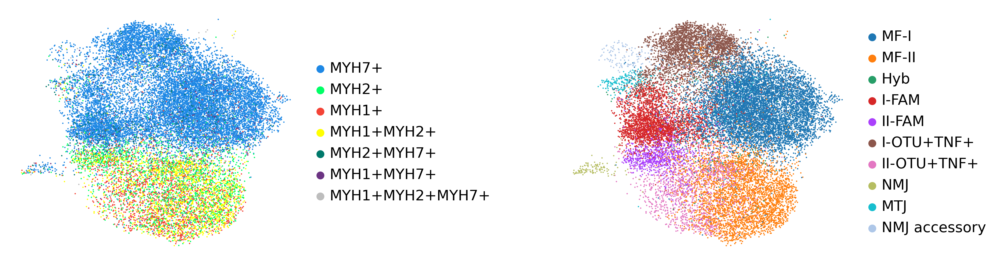

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


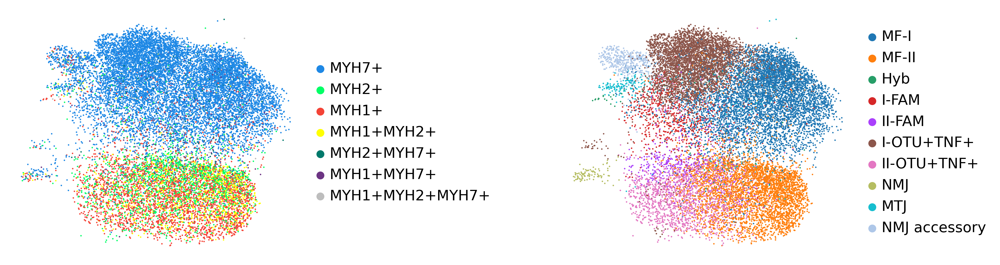

In [16]:
sc.pl.umap(adata_nc_filt[adata_nc_filt.obs['Age_group'] == 'young',:], color = ['myofiber_type','annotation_level1'],\
           frameon = False, title = ["", ""],wspace = 0.7, save = "Myofiber_type_young.pdf")
sc.pl.umap(adata_nc_filt[adata_nc_filt.obs['Age_group'] == 'old',:], color = ['myofiber_type','annotation_level1'],\
           frameon = False, title = ["", ""],wspace = 0.7, save = "Myofiber_type_old.pdf")

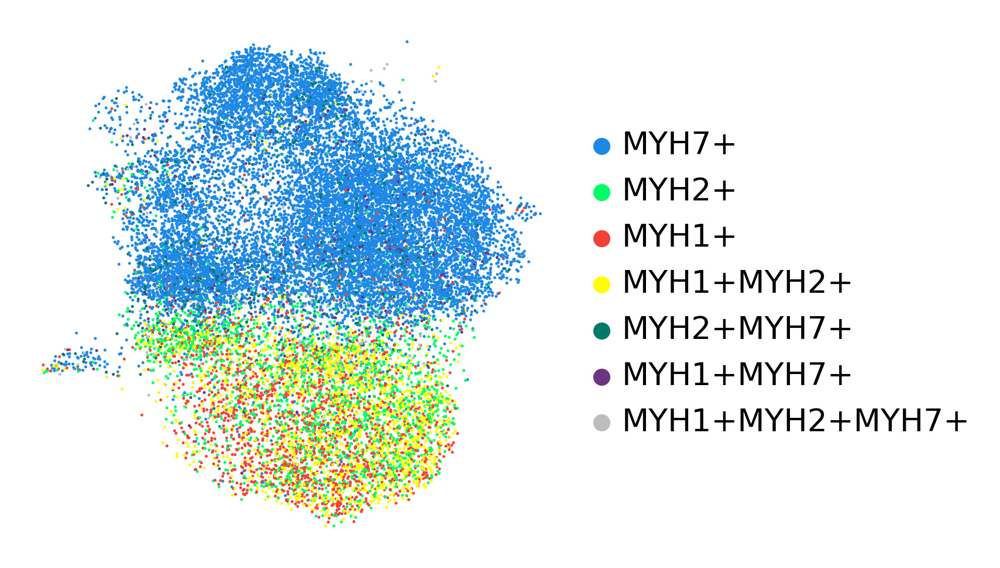

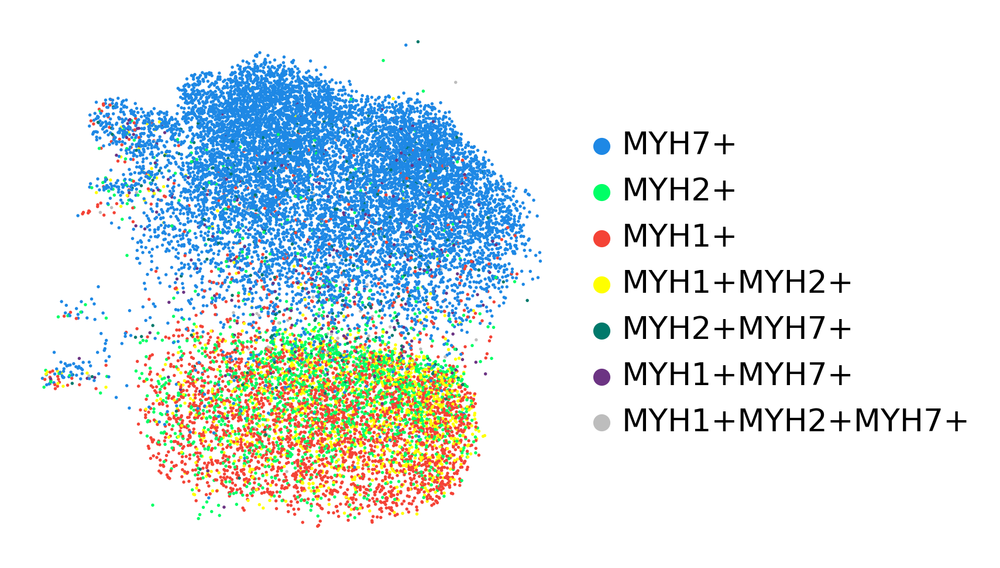

In [17]:
sc.pl.umap(adata_nc_filt[adata_nc_filt.obs['Age_group'] == 'young',:], color = ['myofiber_type'],\
           frameon = False, title = ["", ""],wspace = 0.7, save = "Myofiber_type_young1.pdf")
sc.pl.umap(adata_nc_filt[adata_nc_filt.obs['Age_group'] == 'old',:], color = ['myofiber_type'],\
           frameon = False, title = ["", ""],wspace = 0.7, save = "Myofiber_type_old1.pdf")

In [ ]:
adata_nc_prev = sc.read("/nfs/team205/vk8/processed_data/muscle/data_v3/SKM_myonuclei_re-anno_cleaned_scvi_2021-10-31.h5ad")

adata_nc.obs['annotation_level1'].cat.categories

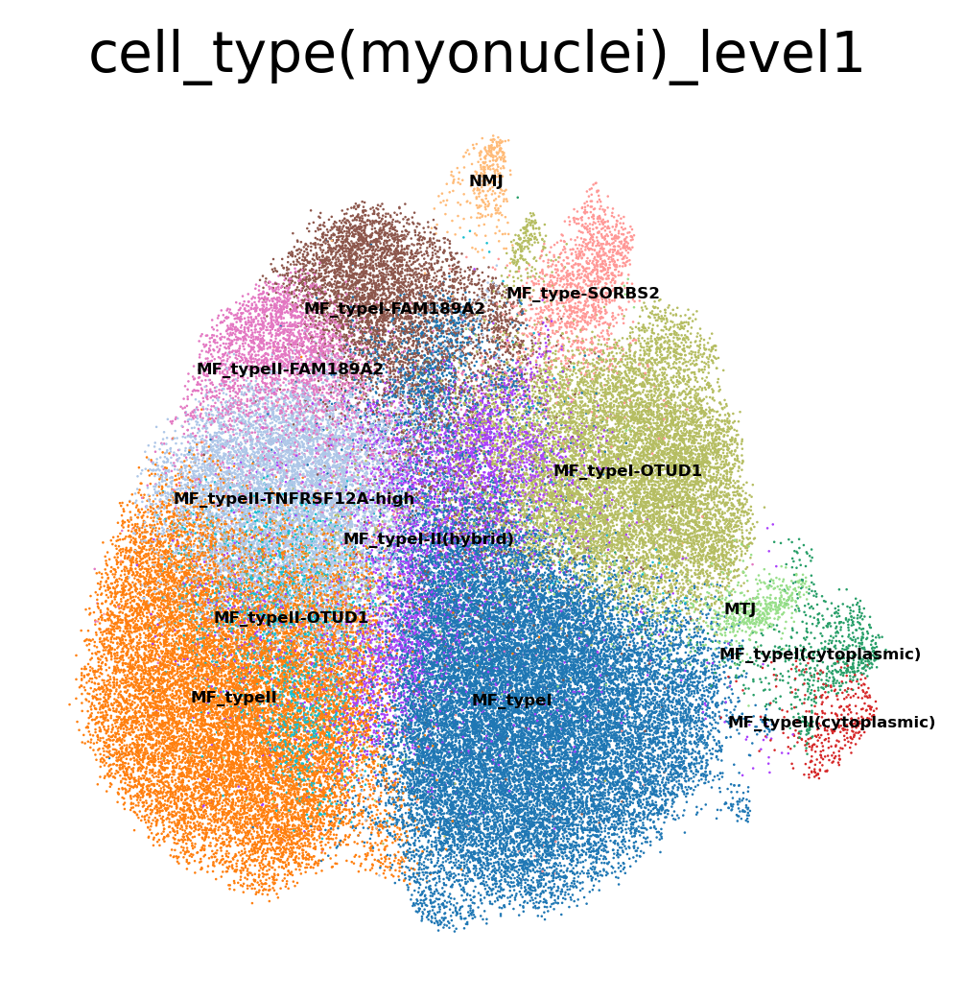

In [36]:
sc.pl.umap(adata_nc_prev, color = 'cell_type(myonuclei)_level1', legend_loc = "on data", legend_fontsize = 4, frameon = False)

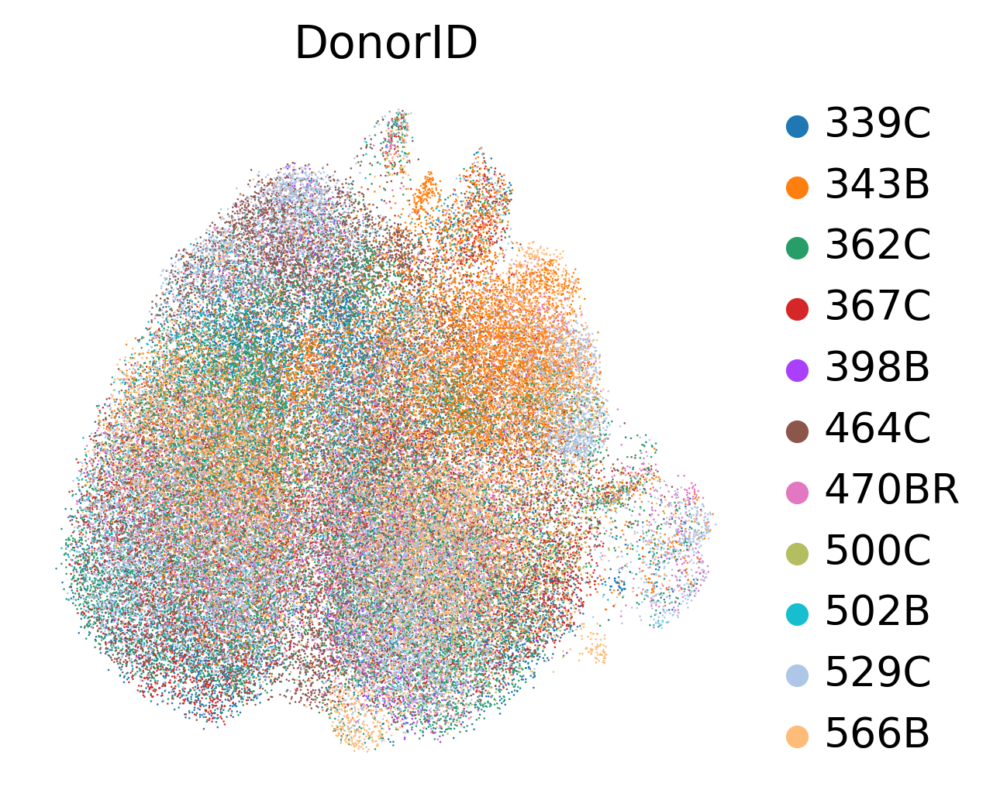

In [38]:
sc.pl.umap(adata_nc_prev, color = 'DonorID', frameon = False)

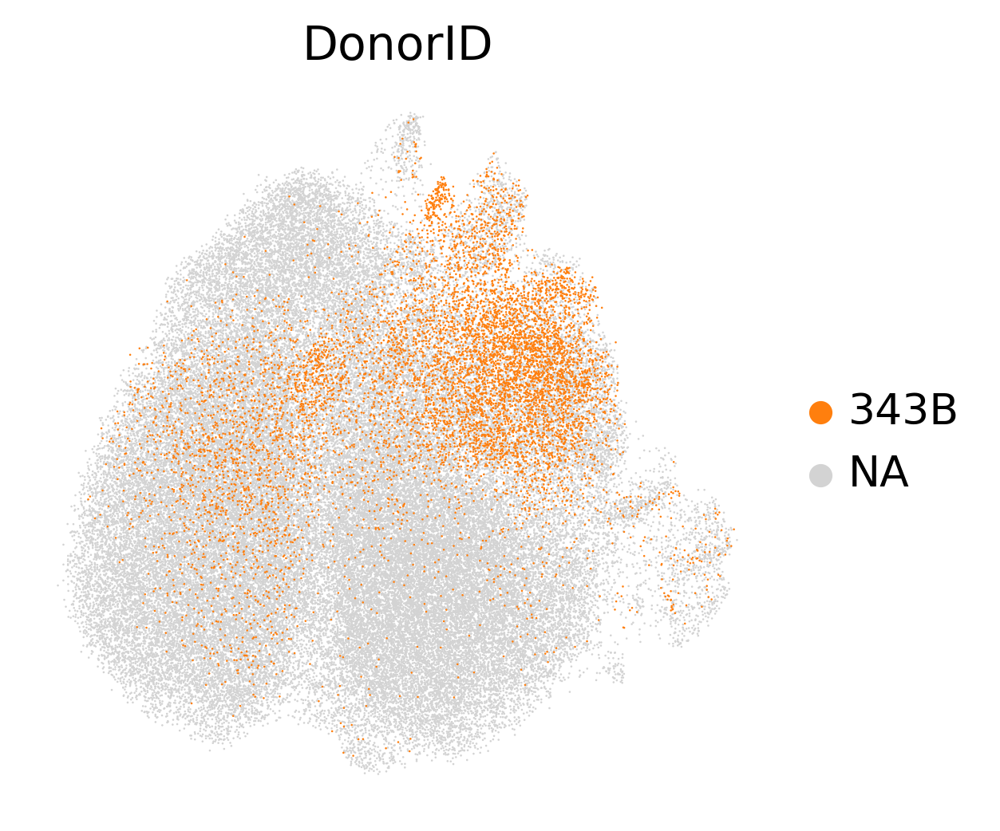

In [39]:
sc.pl.umap(adata_nc_prev, color = 'DonorID', groups = ['343B'], frameon = False)

In [18]:
adata_nc.obs['myofiber_type_filt'].value_counts()

nan                36396
MYH7+              24516
MYH1+               5036
MYH2+               3841
MYH1+MYH2+          3085
MYH2+MYH7+           840
MYH1+MYH7+           637
MYH1+MYH2+MYH7+      275
Name: myofiber_type_filt, dtype: int64

In [16]:
adata_nc.obs['Age_group'] = adata_nc.obs['Age_group'].astype('category')

adata_nc.obs['Age_group'] = adata_nc.obs['Age_group'].cat.reorder_categories(['young', 'old'])

myofiber_order1 = ['MYH7+', 'MYH2+',  'MYH1+MYH2+', 'MYH1+','MYH2+MYH7+', 'MYH1+MYH7+','MYH1+MYH2+MYH7+', 'nan']
myofiber_order2 = ['MYH7+', 'MYH2+',  'MYH1+MYH2+', 'MYH1+','MYH2+MYH7+', 'MYH1+MYH7+','MYH1+MYH2+MYH7+']

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

MYH2+_young vs. MYH2+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:8.357e-01 U_stat=1.900e+01
MYH7+_young vs. MYH7+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.338e-01 U_stat=2.600e+01
MYH1+MYH2+_young vs. MYH1+MYH2+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:7.206e-01 U_stat=1.800e+01
MYH1+_young vs. MYH1+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.343e-01 U_stat=1.200e+01
MYH2+MYH7+_young vs. MYH2+MYH7+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.343e-01 U_stat=3.000e+01
MYH1+MYH7+_young vs. MYH1+MYH7+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.338e-01 U_stat=2

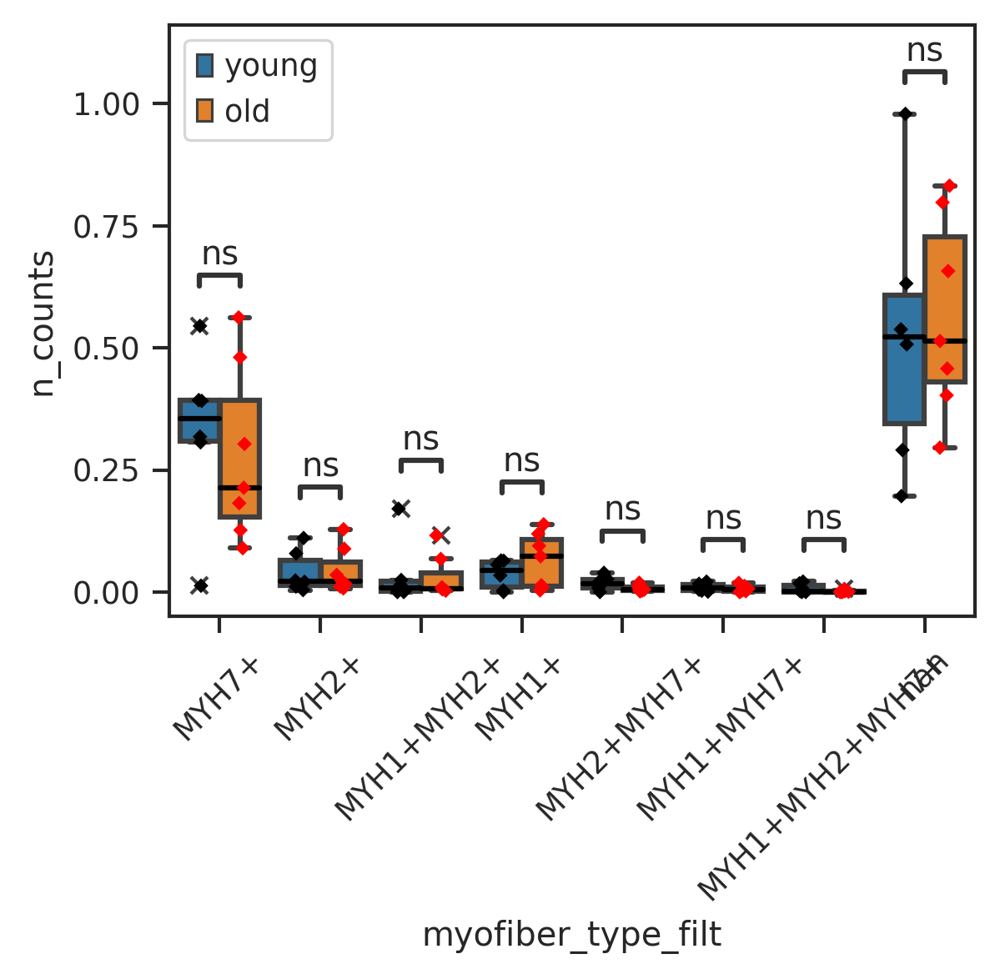

In [17]:
adata_nc2cel_all = calcul_plot_prop_box2(adata_nc, ctype_anno = 'myofiber_type_filt', sample_anno="SampleID", donor_anno="DonorID",
                          age_group="Age_group", filt_samples=False, subset_rm=[], 
                                     subset_sel=myofiber_order1, pairs=[],
                          plot_save='', save_dir='')

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

MYH2+_young vs. MYH2+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:8.357e-01 U_stat=1.900e+01
MYH7+_young vs. MYH7+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.338e-01 U_stat=2.600e+01
MYH1+MYH2+_young vs. MYH1+MYH2+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:7.206e-01 U_stat=1.800e+01
MYH1+_young vs. MYH1+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.343e-01 U_stat=1.200e+01
MYH2+MYH7+_young vs. MYH2+MYH7+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.343e-01 U_stat=3.000e+01
MYH1+MYH7+_young vs. MYH1+MYH7+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.338e-01 U_stat=2

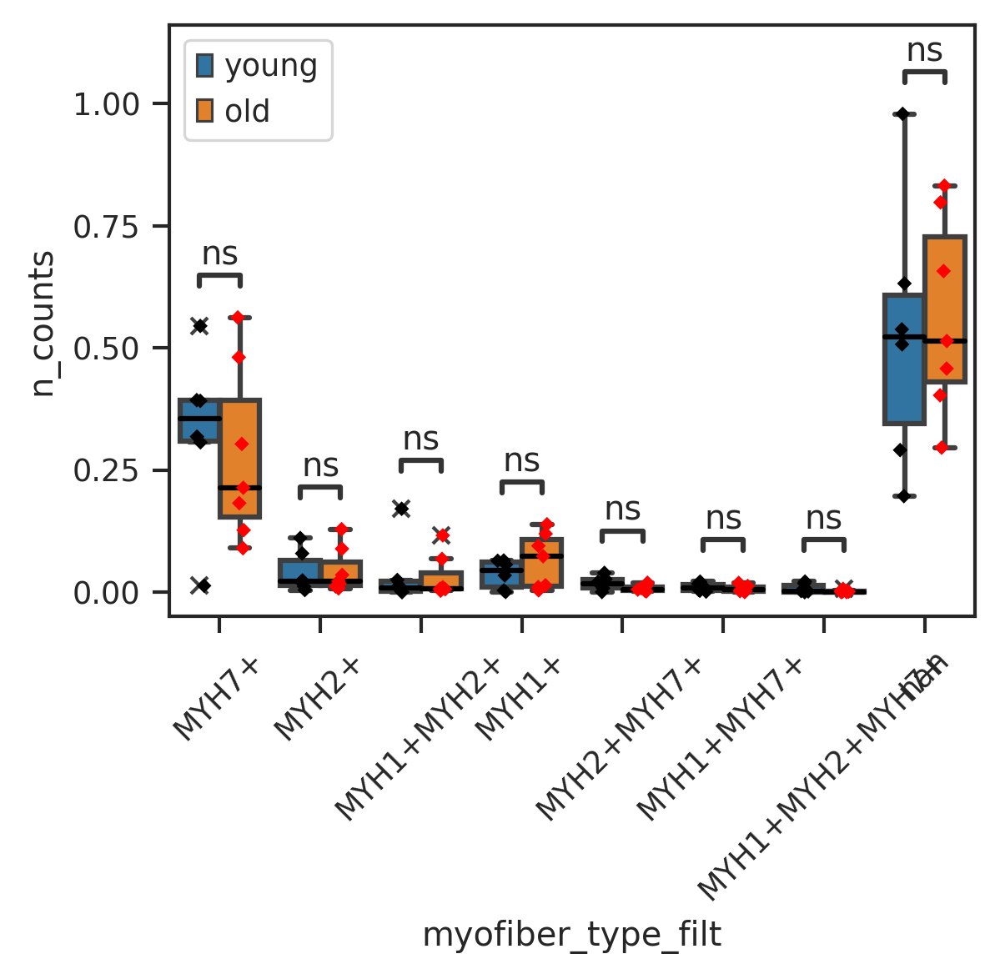

In [18]:
adata_nc2cel_all = calcul_plot_prop_box2(adata_nc, ctype_anno = 'myofiber_type_filt', sample_anno="SampleID", donor_anno="DonorID",
                          age_group="Age_group", filt_samples=False, subset_rm=[], 
                                     subset_sel=myofiber_order1, pairs=[],
                          plot_save='', save_dir='')

In [ ]:
/nfs/team205/vk8/processed_data/muscle/data_v3/updated_icm_snuclei/ICM_myonuclei_scvi1_dbrm_2023-05-07.h5ad

In [21]:
adata_nc

AnnData object with n_obs × n_vars = 74626 × 33538
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', '10X_version', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'Age_group', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'leiden', 'fine_predicted_labels', 'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score', 'coarse_predicted_labels', 'coarse_over_clustering', 'coarse_majority_voting', 'coarse_conf_score', 'leiden_r1.6', 'leiden_r2', 'leiden_r3', 'leiden_r', 'manual_anno', 'myofiber_fine_predicted_labels', 'myofiber_fine_over_clustering', 'myofiber_fine_majority_voting', 'myofiber_fine_conf_score', 'manual_anno2', 'annotation_level0', 'annotation_level1', 'MYH7+', 'MYH1+', 'MYH2+', 'myofiber_type', 'myofiber_type_filt', 'myofiber_type2'
    var:

In [20]:
adata_nc.write('/nfs/team205/vk8/processed_data/muscle/data_v3/updated_icm_snuclei/ICM_myonuclei_scvi1_dbrm_2023-05-07_mftype_upd.h5ad')

In [27]:
adata_nc2cel_all['df'].to_csv(f'{tables}/Myonuclei_myofiber_types_incl_nan.csv', index = False)

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

MYH2+_young vs. MYH2+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:8.357e-01 U_stat=2.300e+01
MYH7+_young vs. MYH7+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:7.308e-01 U_stat=2.400e+01
MYH1+MYH2+_young vs. MYH1+MYH2+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:4.314e-01 U_stat=1.500e+01
MYH1+_young vs. MYH1+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.949e-01 U_stat=1.300e+01
MYH2+MYH7+_young vs. MYH2+MYH7+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.343e-01 U_stat=3.000e+01
MYH1+MYH7+_young vs. MYH1+MYH7+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.807e-01 U_stat=3

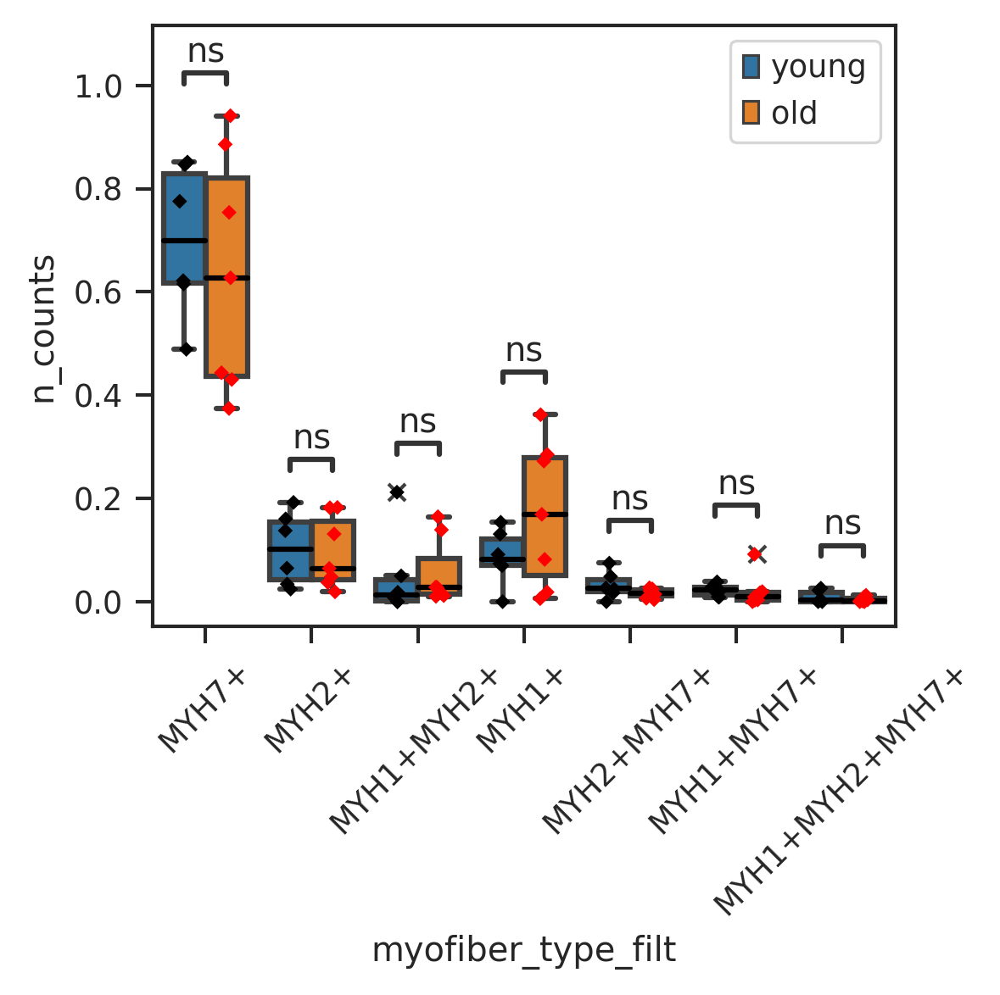

In [23]:
adata_nc2ce_na_filt = calcul_plot_prop_box2(adata_nc, ctype_anno = 'myofiber_type_filt', sample_anno="SampleID", donor_anno="DonorID",
                          age_group="Age_group", filt_samples=False, subset_rm=['nan'], 
                                     subset_sel=myofiber_order2, pairs=[],
                          plot_save='', save_dir='')

In [30]:
adata_nc2ce_na_filt['df'].to_csv(f'{tables}/Myonuclei_myofiber_types_nan_rm.csv', index = False)

### 10. Plot spliced vs unspliced ratios 
- need to change environment to scvelo

In [4]:
import scvelo as scv
from matplotlib import pyplot as plt
plt.rcParams["axes.grid"] = False

In [5]:
adata_myofiber2myonuclei = sc.read('/nfs/team205/vk8/processed_data/muscle/data_v3/Myofiber2myonuclei_scvi_integration_mod_2023-05-10.h5ad')

In [6]:
adata_all_raw = sc.read("/nfs/team205/vk8/processed_data/muscle/data_v3/ICM_scell2snuclei_data_raw_all_layers_2023-05-09.h5ad")

In [7]:
adata_all_raw_filt = adata_all_raw[~adata_all_raw.obs['annotation_level2'].isnull()]

In [19]:
adata_all_raw_filt.obs['is_myofiber'] = adata_all_raw_filt.obs.apply(lambda x: 'Myofiber' if x['annotation_level0'] in ['MF-I', 'MF-II', 'MF-IIsc(fg)',
       'MF-IIsn(fg)', 'MF-Isc(fg)', 'MF-Isn(fg)','Hyb','Specialised MF'] else 'Non-myofiber', axis = 1)

In [20]:
del adata_all_raw
import gc
gc.collect()

924

In [70]:
adata_mf2mn_vc = adata_all_raw[adata_myofiber2myonuclei.obs_names, :].copy()

In [74]:
adata_mf2mn_vc.obs['annotation_level0_fig'] = adata_myofiber2myonuclei.obs.reindex(adata_mf2mn_vc.obs_names)['annotation_level0_fig'].copy()

In [78]:
adata_mf2mn_vc.obs['annotation_level2'] = adata_myofiber2myonuclei.obs.reindex(adata_mf2mn_vc.obs_names)['annotation_level2'].copy()

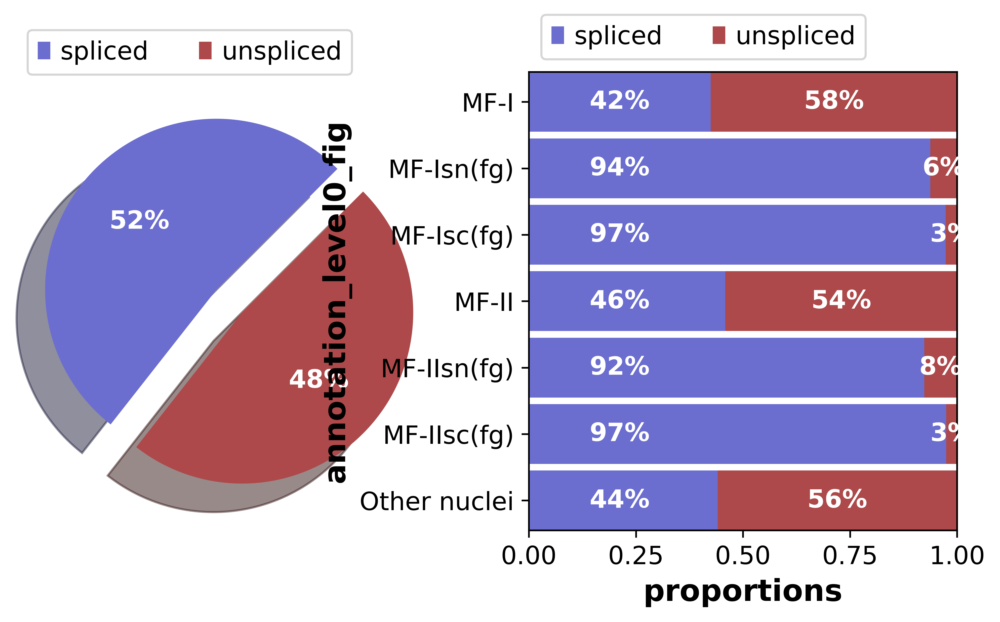

In [77]:
rcParams['pdf.fonttype'] = 42
ax = scv.pl.proportions(adata_mf2mn_vc[], groupby = 'annotation_level0_fig', add_labels_pie=True, fontsize=12, figsize=(8, 4), dpi = 300,  show=False);
scv.pl.utils.savefig_or_show()#save='Myofiber_cells_general_proportions.pdf')

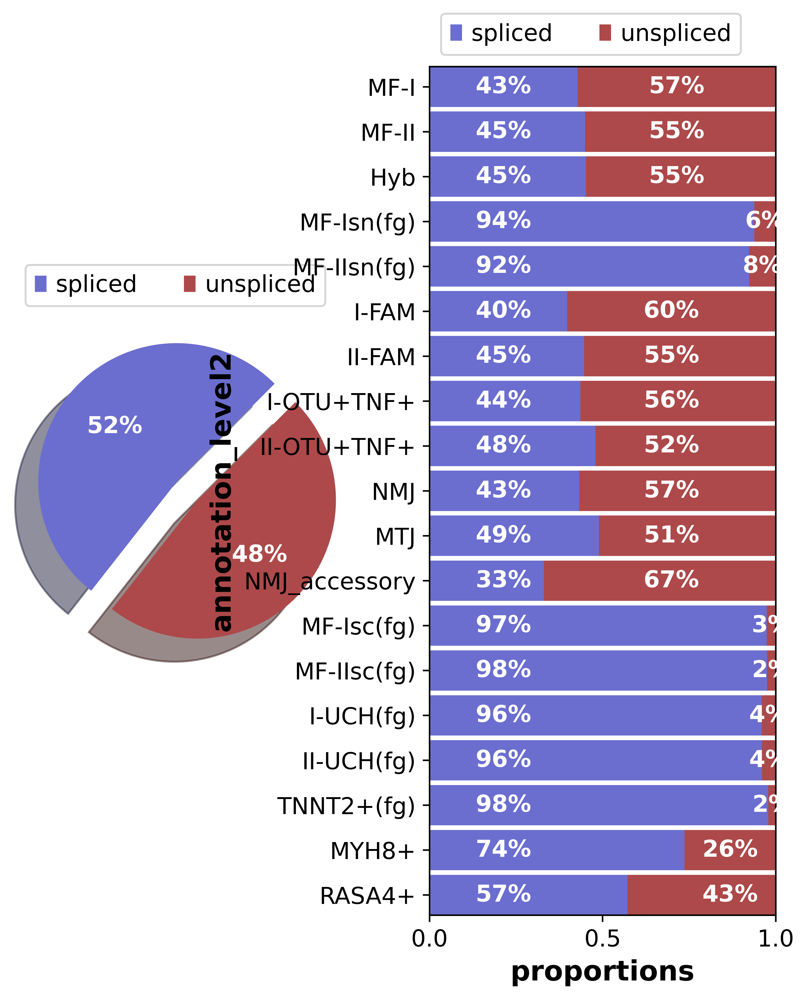

In [83]:
rcParams['pdf.fonttype'] = 42
ax = scv.pl.proportions(adata_mf2mn_vc, groupby = 'annotation_level2', add_labels_pie=True, fontsize=12, figsize=(7, 8), dpi = 300,  show=False);
scv.pl.utils.savefig_or_show()#save='Myofiber_cells_general_proportions.pdf')

In [23]:
adata_all_raw_filt[(adata_all_raw_filt.obs['is_myofiber'] == 'Myofiber') & 
                                           (adata_all_raw_filt.obs['batch'] == 'nuclei'),:]

View of AnnData object with n_obs × n_vars = 74626 × 33538
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', '10X_version', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'Age_group', 'batch', 'annotation_level0', 'annotation_level1', 'annotation_level2', 'is_myofiber'
    var: 'ENSEMBL', 'SYMBOL', 'n_counts-cells', 'n_cells-cells', 'n_counts-nuclei', 'n_cells-nuclei'
    layers: 'ambiguous', 'raw', 'spliced', 'unspliced'

saving figure to file ./figures/scvelo_Myofiber_nuclei_pie_pct_spliced.pdf


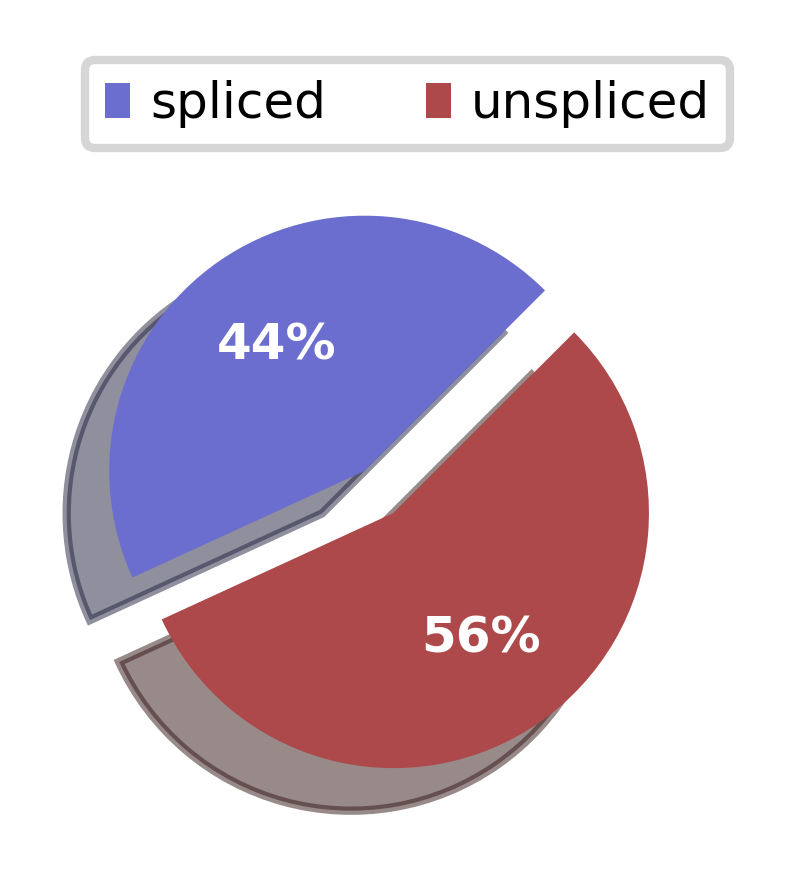

In [28]:
rcParams['pdf.fonttype'] = 42
ax = scv.pl.proportions(adata_all_raw_filt[(adata_all_raw_filt.obs['is_myofiber'] == 'Myofiber') & 
                                           (adata_all_raw_filt.obs['batch'] == 'nuclei'),:],  fontsize=6, figsize=(3, 3), dpi = 300,  show=False);
scv.pl.utils.savefig_or_show(save='Myofiber_nuclei_pie_pct_spliced.pdf')

saving figure to file ./figures/scvelo_Myofiber_cells_pie_pct_spliced.pdf


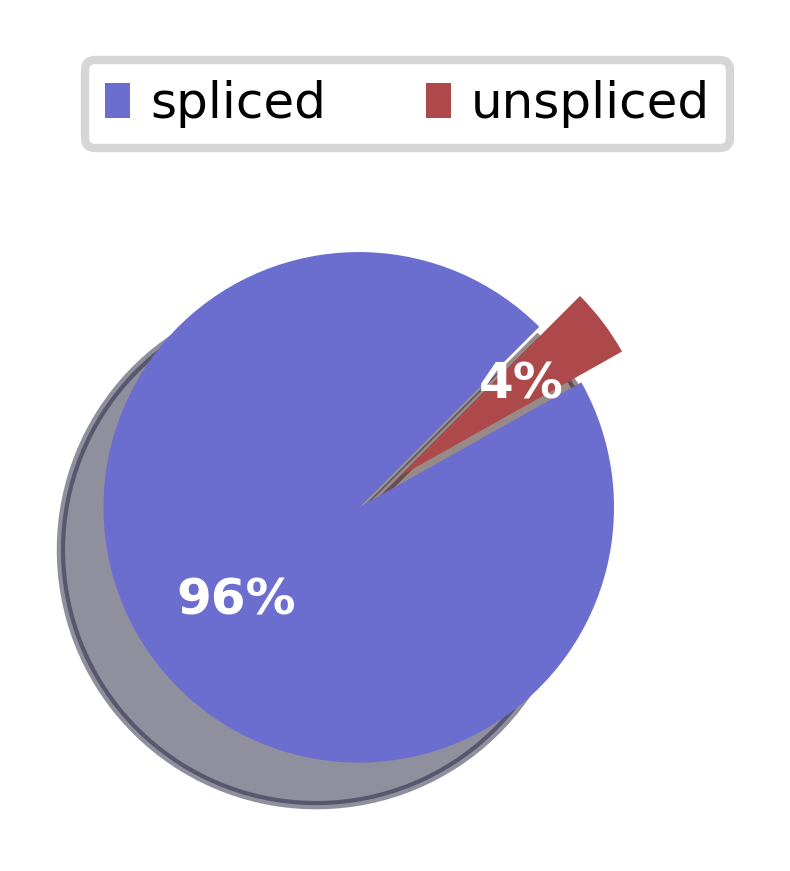

In [30]:
rcParams['pdf.fonttype'] = 42
ax = scv.pl.proportions(adata_all_raw_filt[(adata_all_raw_filt.obs['is_myofiber'] == 'Myofiber') & 
                                           (adata_all_raw_filt.obs['batch'] == 'cells'),:],  fontsize=6, figsize=(3, 3), dpi = 300,  show=False);
scv.pl.utils.savefig_or_show(save='Myofiber_cells_pie_pct_spliced.pdf')

saving figure to file ./figures/scvelo_Non-Myofiber_nuclei_pie_pct_spliced.pdf


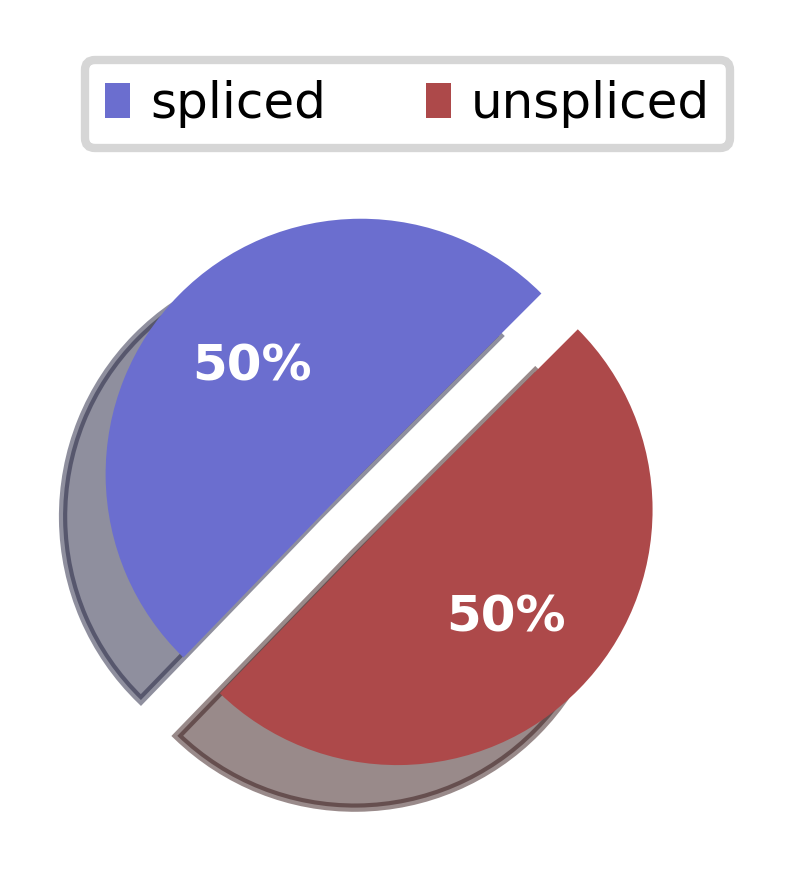

In [31]:
rcParams['pdf.fonttype'] = 42
ax = scv.pl.proportions(adata_all_raw_filt[(adata_all_raw_filt.obs['is_myofiber'] == 'Non-myofiber') & 
                                           (adata_all_raw_filt.obs['batch'] == 'nuclei'),:],  fontsize=6, figsize=(3, 3), dpi = 300,  show=False);
scv.pl.utils.savefig_or_show(save='Non-Myofiber_nuclei_pie_pct_spliced.pdf')

saving figure to file ./figures/scvelo_Non-Myofiber_cells_pie_pct_spliced.pdf


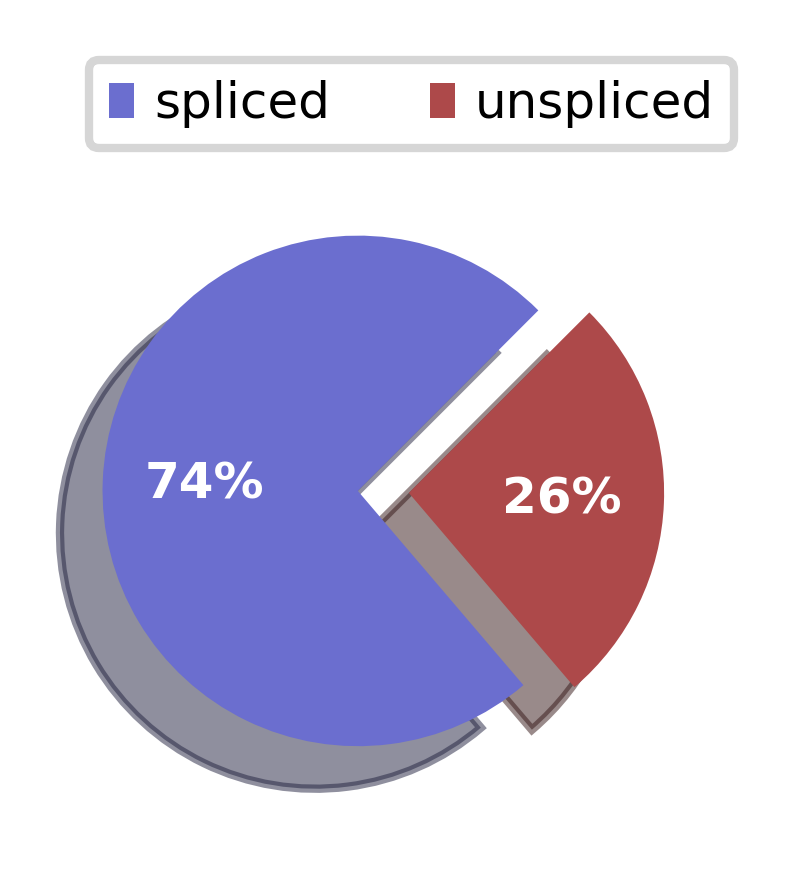

In [32]:
rcParams['pdf.fonttype'] = 42
ax = scv.pl.proportions(adata_all_raw_filt[(adata_all_raw_filt.obs['is_myofiber'] == 'Non-myofiber') & 
                                           (adata_all_raw_filt.obs['batch'] == 'cells'),:],  fontsize=6, figsize=(3, 3), dpi = 300,  show=False);
scv.pl.utils.savefig_or_show(save='Non-Myofiber_cells_pie_pct_spliced.pdf')